# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [4]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [5]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [6]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [7]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()),dim=1)
    #### END CODE HERE ####
    return combined

In [8]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [9]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [10]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [11]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [12]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [13]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.2842124881744383, discriminator loss: 0.2406357742100954


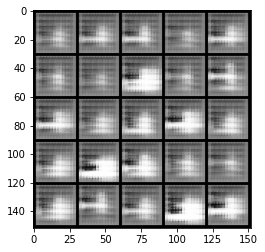

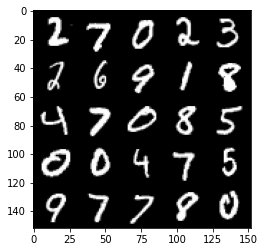

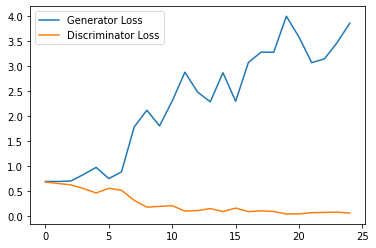

Step 1000: Generator loss: 4.622067843437195, discriminator loss: 0.04570162384770811


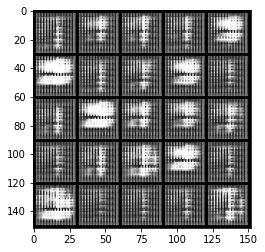

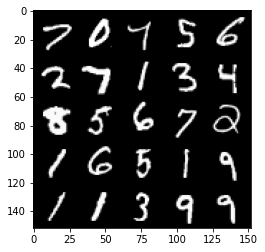

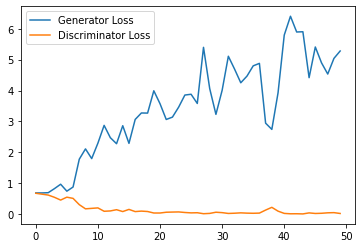

Step 1500: Generator loss: 5.174339558601379, discriminator loss: 0.037452254756353796


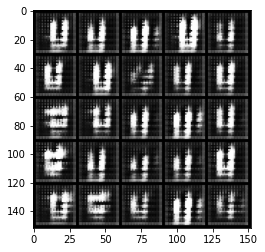

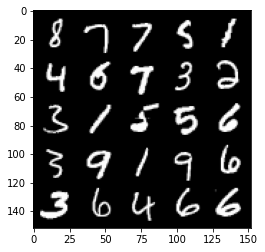

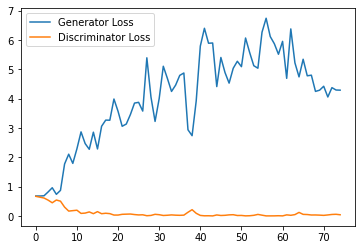

Step 2000: Generator loss: 4.269330451488495, discriminator loss: 0.04720941017381847


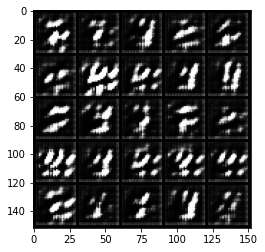

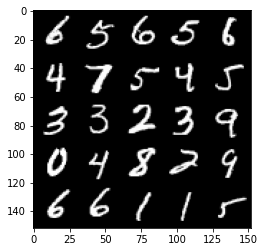

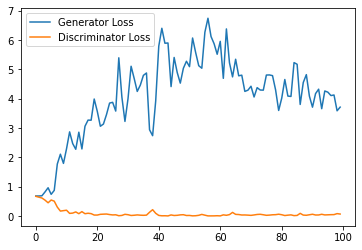

Step 2500: Generator loss: 3.3036027932167054, discriminator loss: 0.12656326845288277


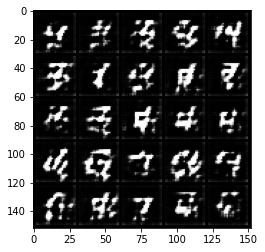

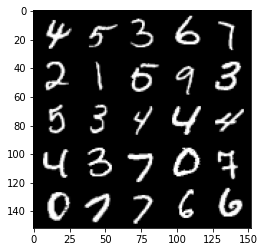

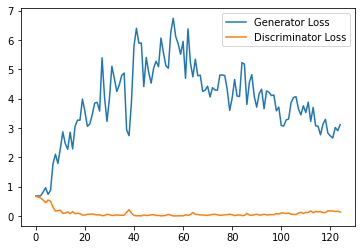

Step 3000: Generator loss: 2.9511606547832487, discriminator loss: 0.20228964321315288


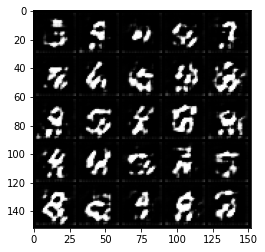

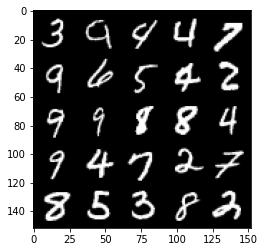

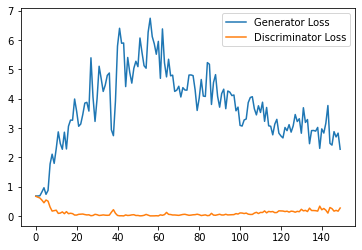

Step 3500: Generator loss: 2.5995418717861174, discriminator loss: 0.2233925583064556


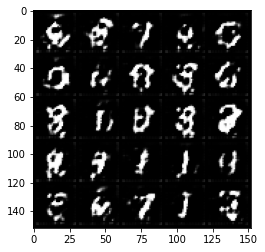

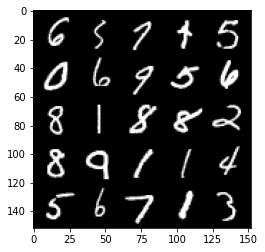

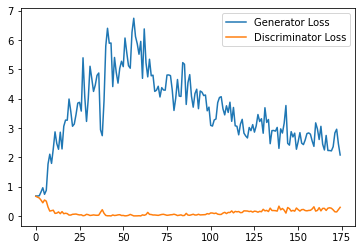

Step 4000: Generator loss: 2.3542133376598358, discriminator loss: 0.2744064423143864


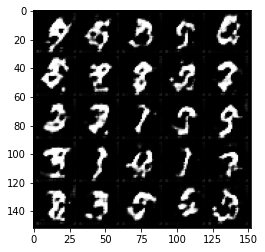

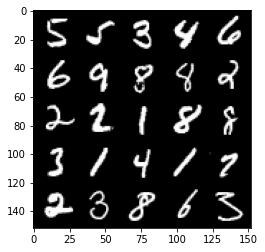

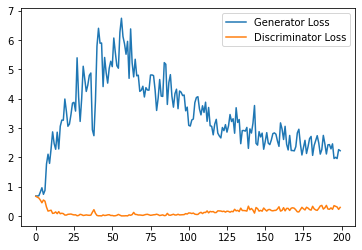

Step 4500: Generator loss: 2.2009578948020936, discriminator loss: 0.29835739777982234


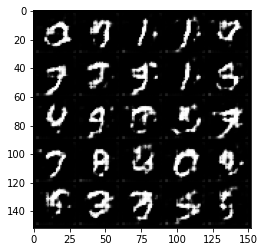

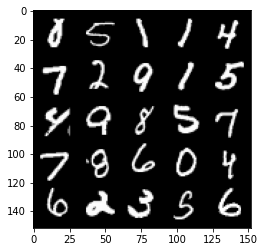

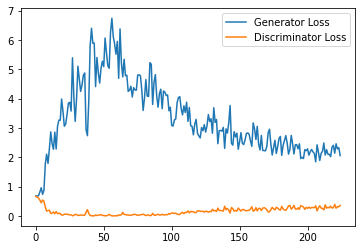

Step 5000: Generator loss: 2.110031030893326, discriminator loss: 0.3245764590203762


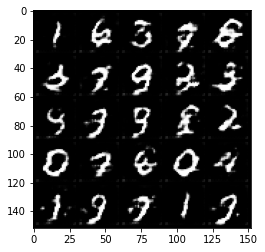

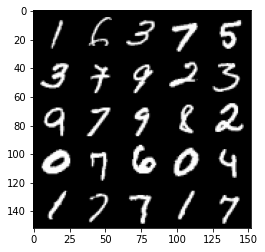

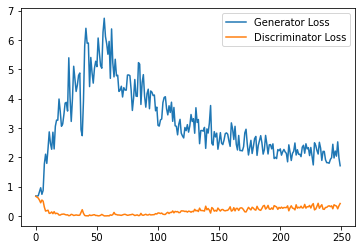

Step 5500: Generator loss: 1.9152003231048584, discriminator loss: 0.3513589549064636


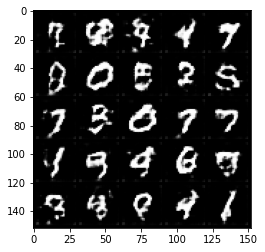

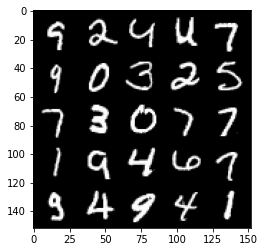

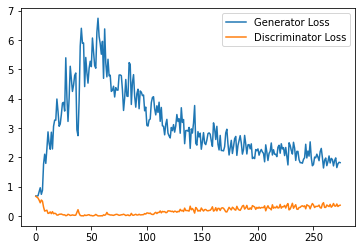

Step 6000: Generator loss: 1.7984325413703919, discriminator loss: 0.3780279643535614


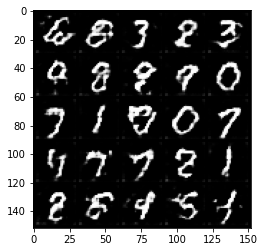

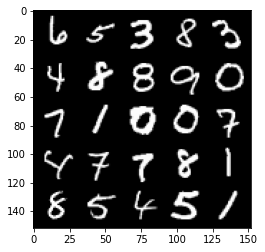

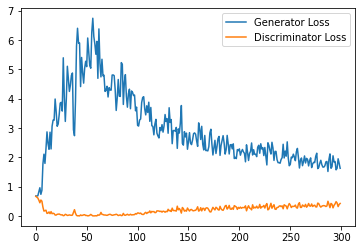

Step 6500: Generator loss: 1.734058901309967, discriminator loss: 0.40158813261985776


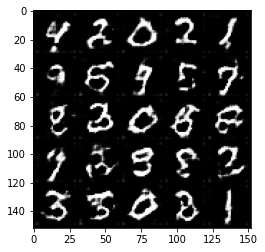

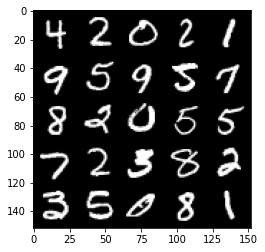

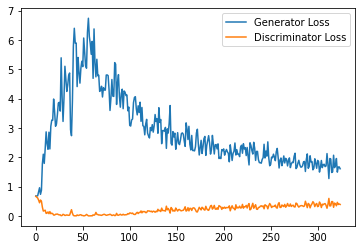

Step 7000: Generator loss: 1.6609828474521637, discriminator loss: 0.4315306542515755


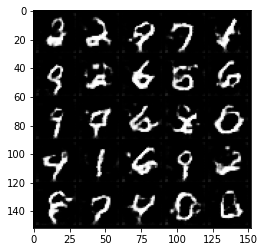

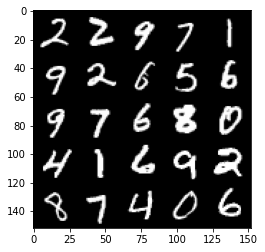

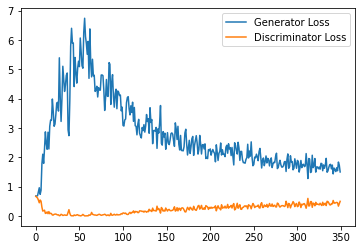

Step 7500: Generator loss: 1.4682208923101425, discriminator loss: 0.46397492438554766


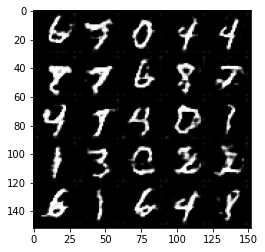

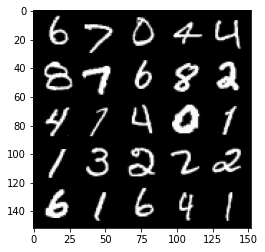

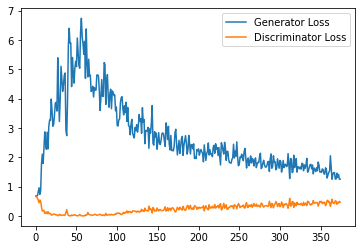

Step 8000: Generator loss: 1.3976651127338409, discriminator loss: 0.4841615841388702


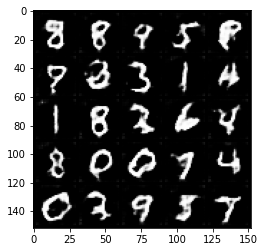

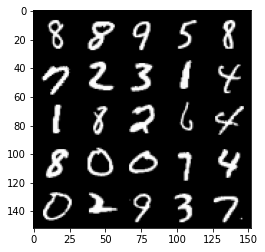

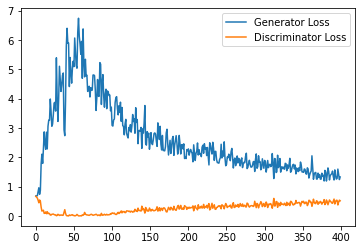

Step 8500: Generator loss: 1.4297066581249238, discriminator loss: 0.5154777480959892


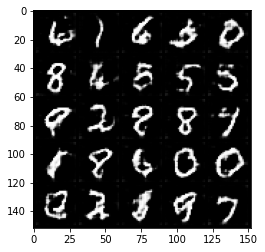

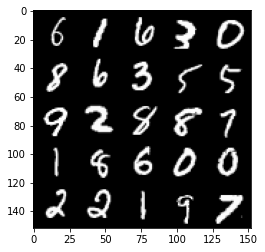

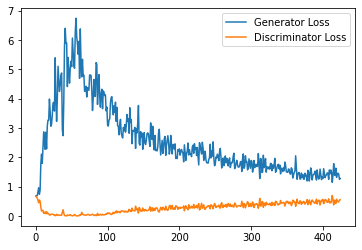

Step 9000: Generator loss: 1.335989468574524, discriminator loss: 0.5093177595138549


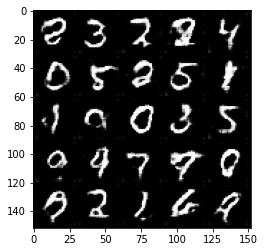

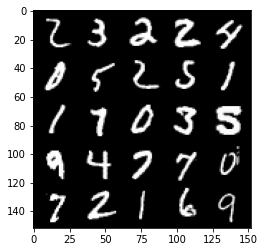

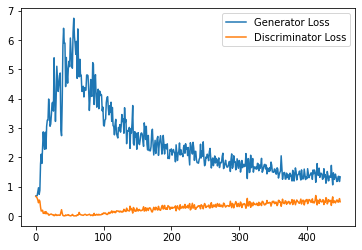

Step 9500: Generator loss: 1.3501415749788284, discriminator loss: 0.5266344368457794


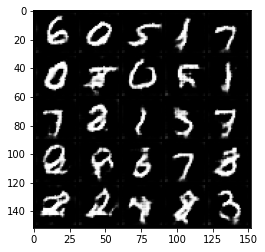

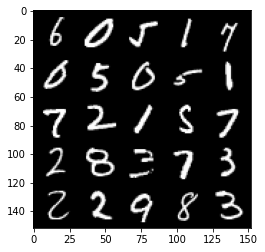

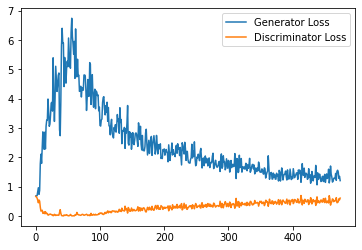

Step 10000: Generator loss: 1.2732537281513214, discriminator loss: 0.5361222942471504


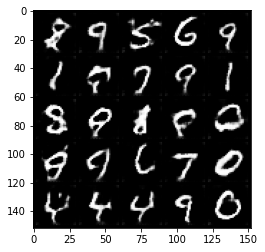

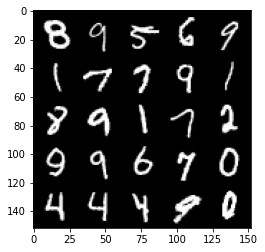

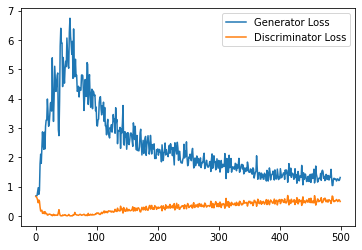

Step 10500: Generator loss: 1.2731290012598038, discriminator loss: 0.5449430362582207


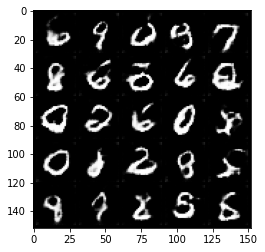

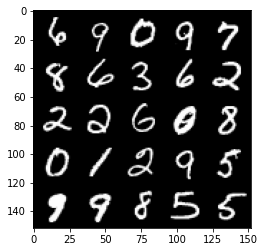

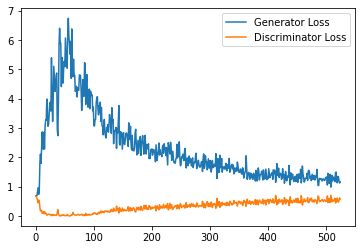

Step 11000: Generator loss: 1.1915087147951127, discriminator loss: 0.5757617998719216


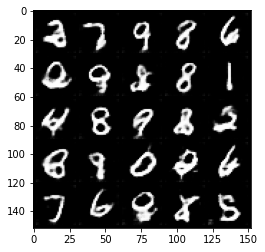

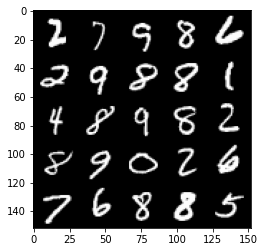

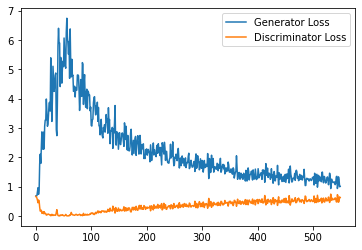

Step 11500: Generator loss: 1.1352818521261214, discriminator loss: 0.5617768442034722


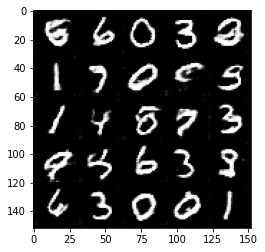

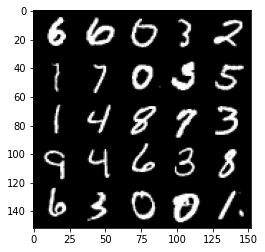

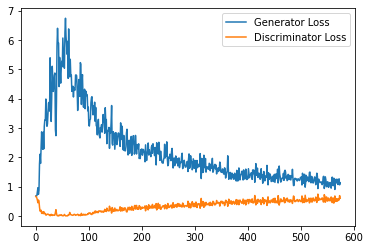

Step 12000: Generator loss: 1.1827313169240952, discriminator loss: 0.5598921386003495


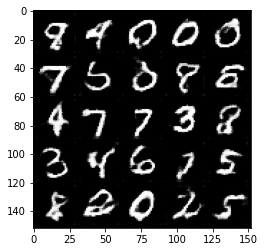

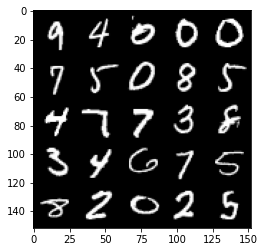

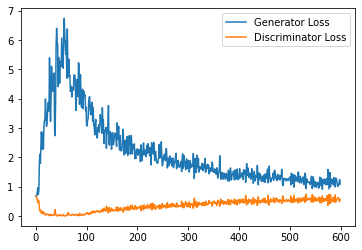

Step 12500: Generator loss: 1.1493374404907226, discriminator loss: 0.571069302380085


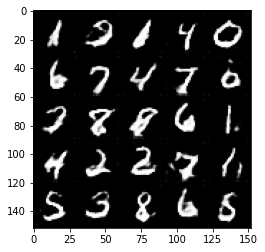

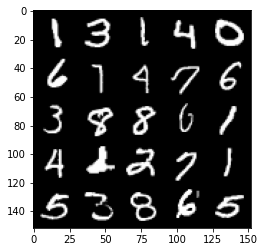

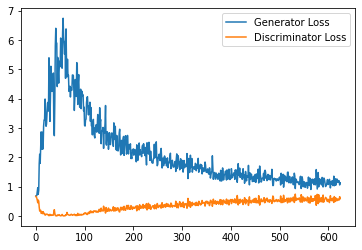

Step 13000: Generator loss: 1.128514622926712, discriminator loss: 0.5713012942075729


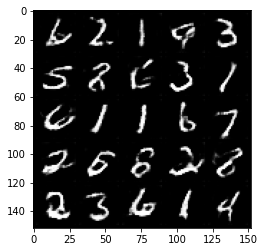

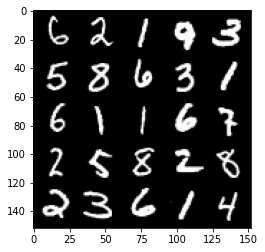

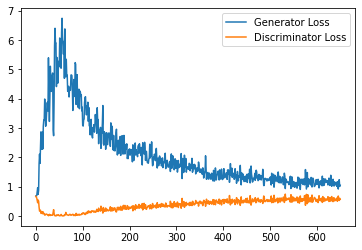

Step 13500: Generator loss: 1.1755740770101548, discriminator loss: 0.5918251392245293


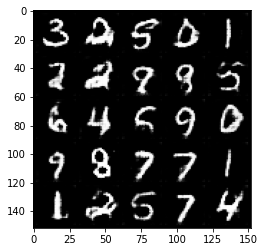

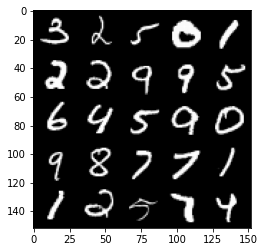

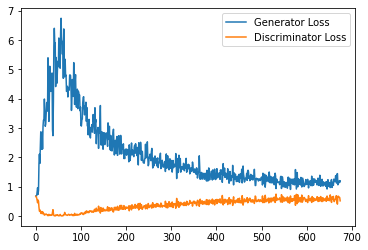

Step 14000: Generator loss: 1.1358214099407196, discriminator loss: 0.5796533935070037


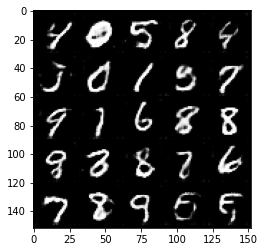

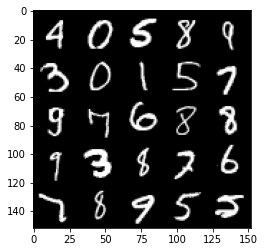

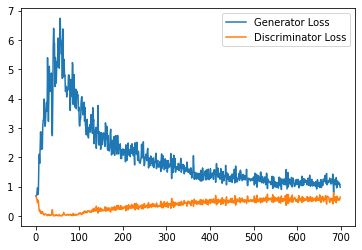

Step 14500: Generator loss: 1.0591342513561248, discriminator loss: 0.5849845446348191


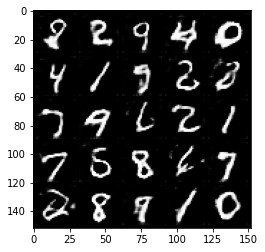

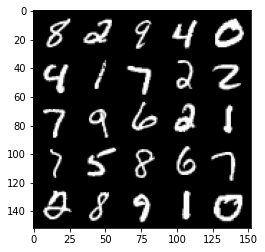

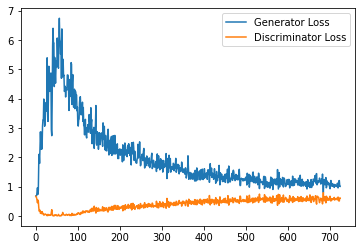

Step 15000: Generator loss: 1.074400849223137, discriminator loss: 0.5976286006569862


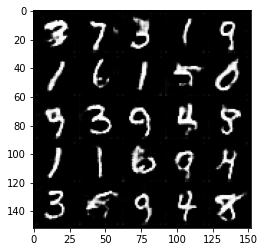

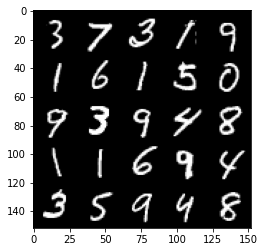

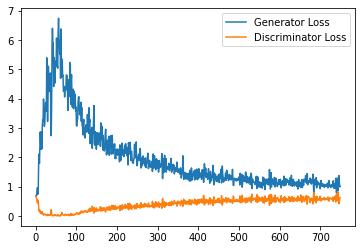

Step 15500: Generator loss: 1.0994641833305359, discriminator loss: 0.5972237092256546


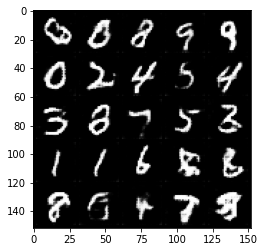

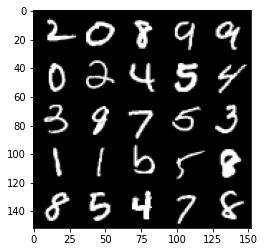

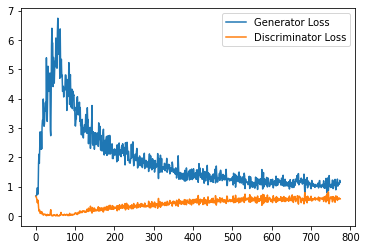

Step 16000: Generator loss: 1.0641474170684815, discriminator loss: 0.5986333335638047


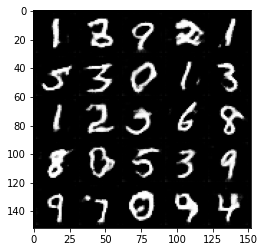

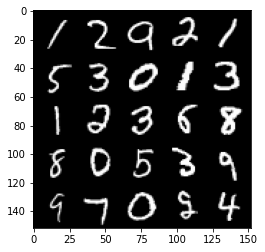

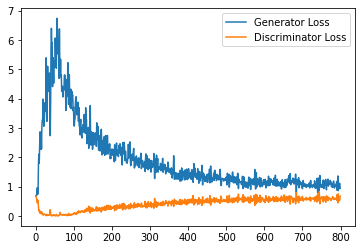

Step 16500: Generator loss: 1.040530665755272, discriminator loss: 0.5950620466470719


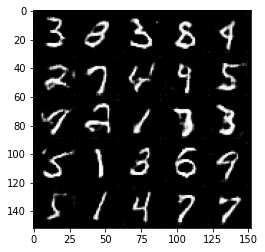

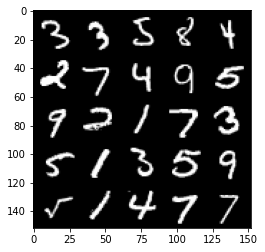

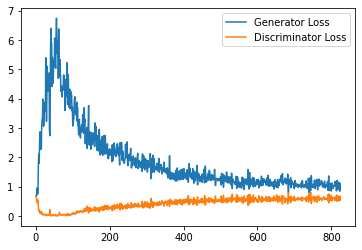

Step 17000: Generator loss: 1.0100371747016907, discriminator loss: 0.6045184835195542


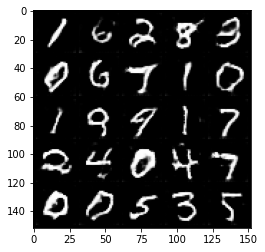

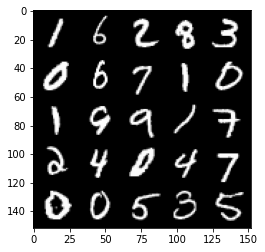

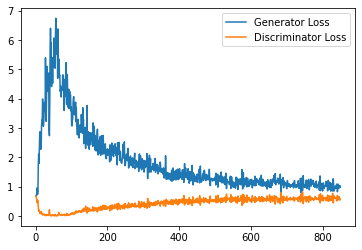

Step 17500: Generator loss: 0.9945044813156128, discriminator loss: 0.6047732174992562


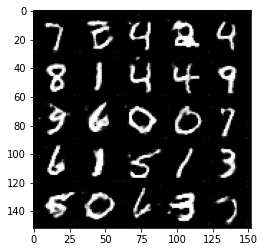

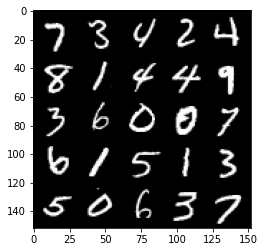

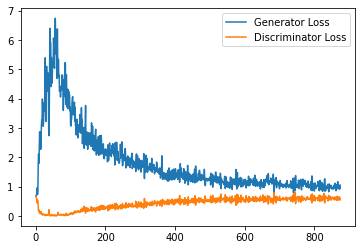

Step 18000: Generator loss: 1.037643854856491, discriminator loss: 0.6063690456748009


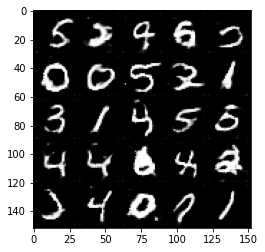

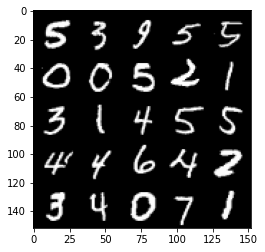

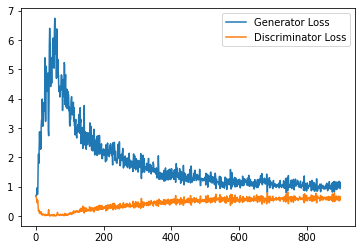

Step 18500: Generator loss: 1.0492442387342453, discriminator loss: 0.6052821326851845


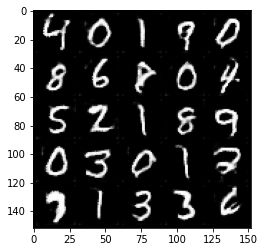

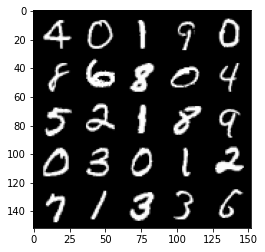

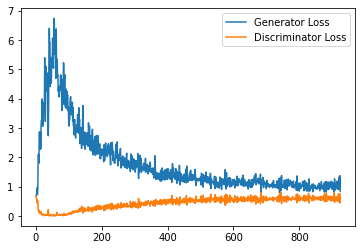

Step 19000: Generator loss: 1.0445329442024232, discriminator loss: 0.5900528497695923


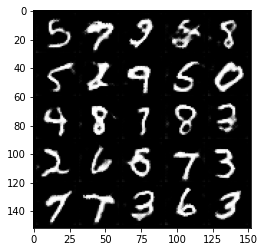

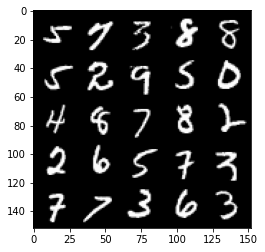

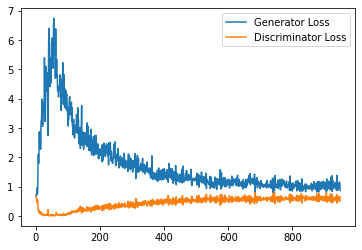

Step 19500: Generator loss: 1.02439580142498, discriminator loss: 0.5977957490086555


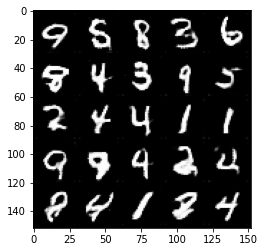

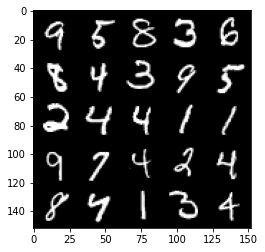

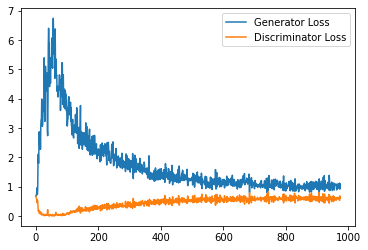

Step 20000: Generator loss: 1.0163444678783418, discriminator loss: 0.5897838541269302


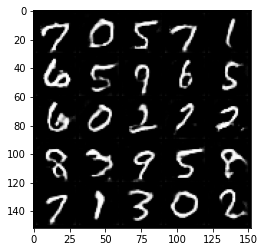

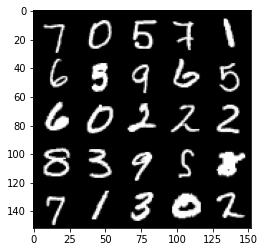

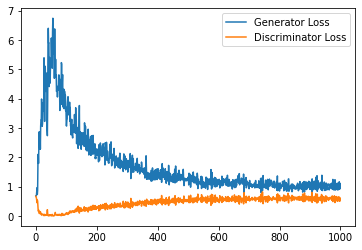

Step 20500: Generator loss: 1.0034908301830292, discriminator loss: 0.6044062181115151


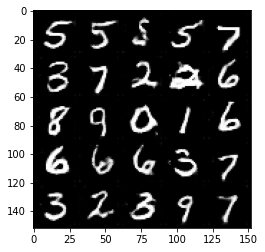

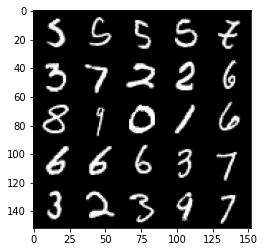

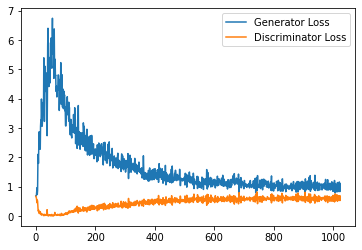

Step 21000: Generator loss: 1.0050996527671814, discriminator loss: 0.6007189226150512


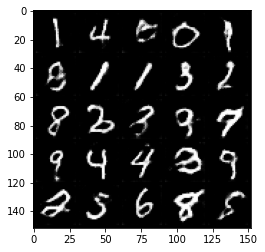

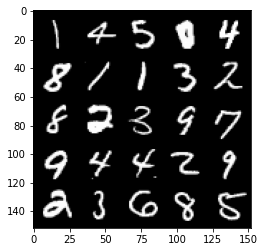

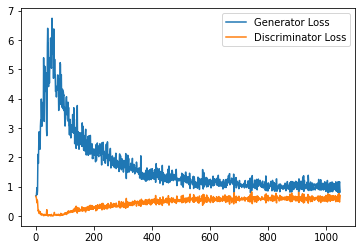

Step 21500: Generator loss: 1.0130980336666107, discriminator loss: 0.5916282407045365


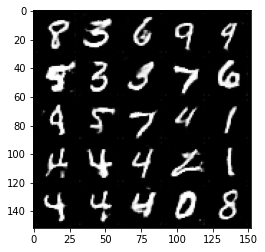

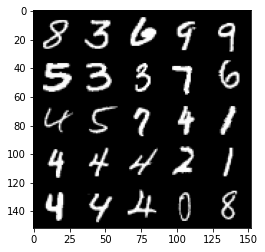

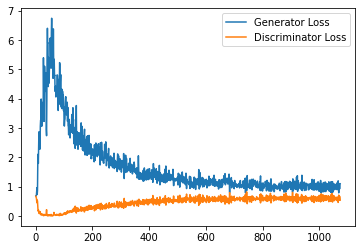

Step 22000: Generator loss: 0.9815618369579315, discriminator loss: 0.5975661746263504


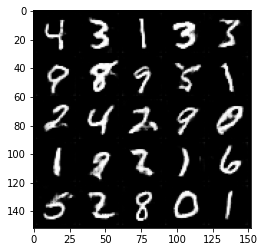

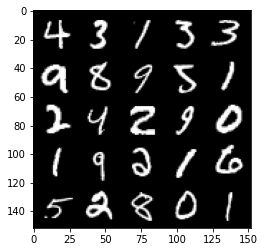

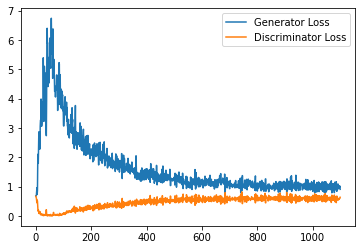

Step 22500: Generator loss: 1.0186996639966965, discriminator loss: 0.591079635322094


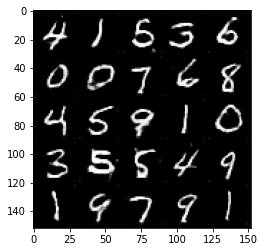

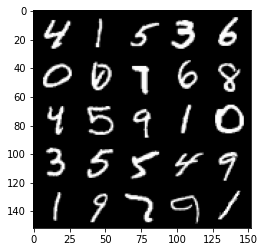

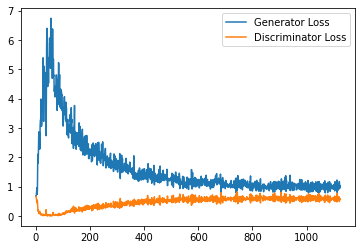

Step 23000: Generator loss: 1.0066146124601365, discriminator loss: 0.5928630595207214


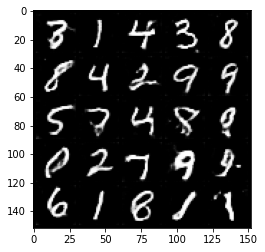

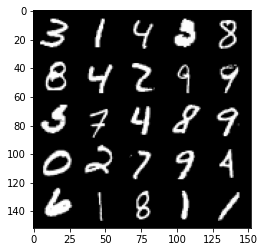

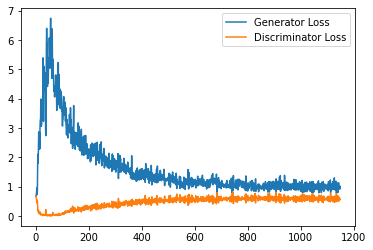

Step 23500: Generator loss: 0.9993175461292266, discriminator loss: 0.5932599530220032


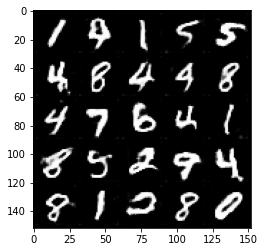

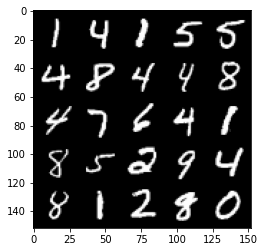

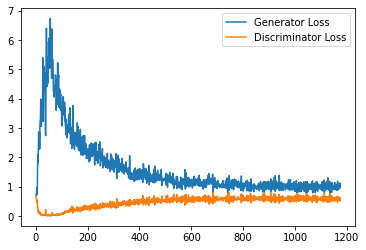

Step 24000: Generator loss: 1.0128717228174209, discriminator loss: 0.5885143492817879


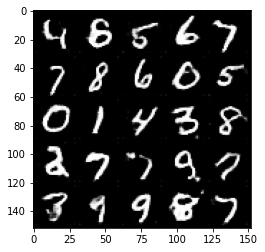

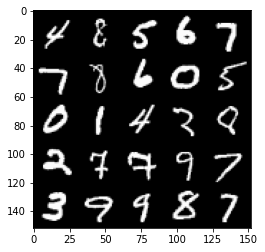

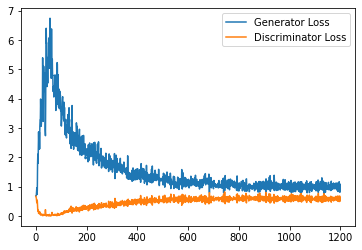

Step 24500: Generator loss: 1.011906700015068, discriminator loss: 0.5891495186686516


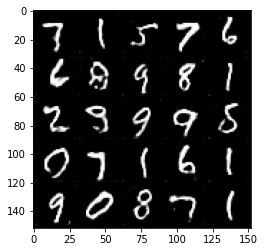

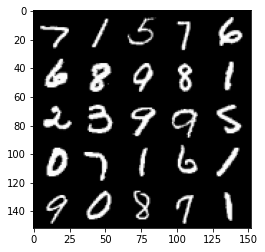

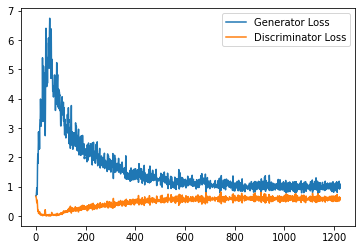

Step 25000: Generator loss: 1.012090026497841, discriminator loss: 0.5900397125482559


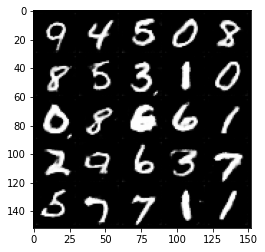

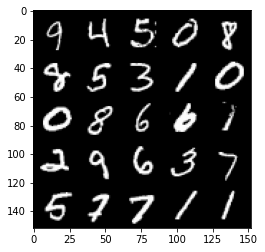

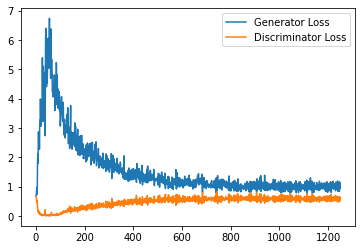

Step 25500: Generator loss: 0.9998937511444091, discriminator loss: 0.5870364907979965


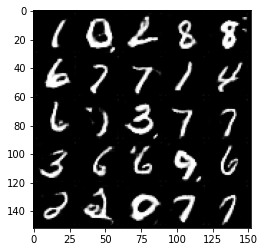

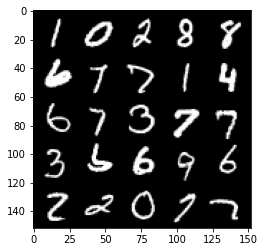

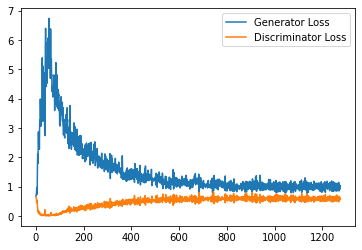

Step 26000: Generator loss: 1.0002980811595916, discriminator loss: 0.5896087950468063


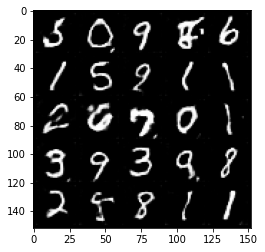

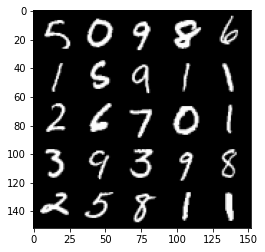

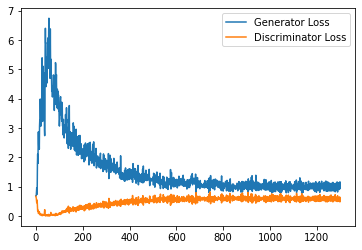

Step 26500: Generator loss: 0.9867952305078507, discriminator loss: 0.5883123304247856


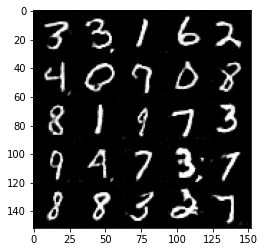

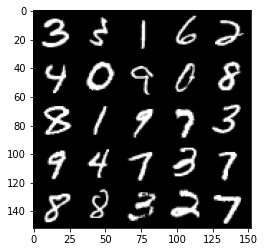

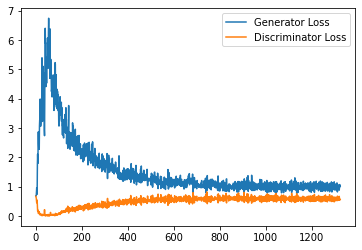

Step 27000: Generator loss: 1.030301568388939, discriminator loss: 0.5835061667561531


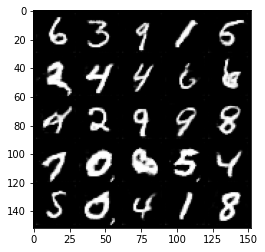

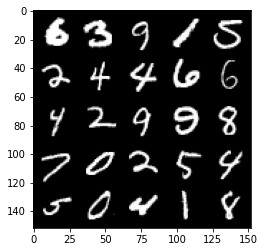

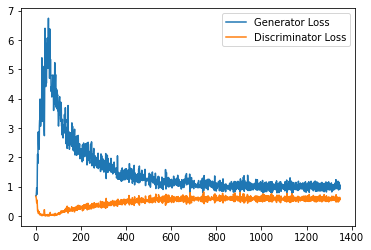

Step 27500: Generator loss: 1.0162847731113434, discriminator loss: 0.5839771872758865


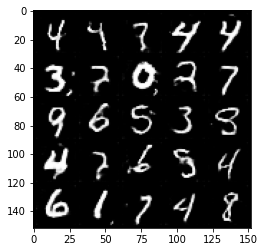

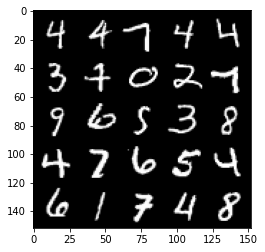

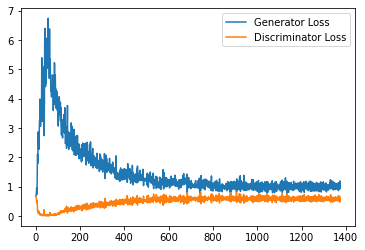

Step 28000: Generator loss: 0.9932426373958587, discriminator loss: 0.5903597756028175


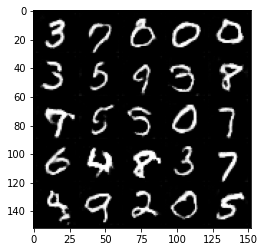

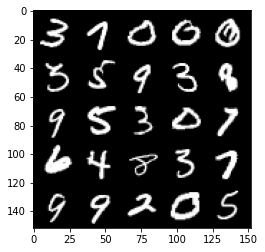

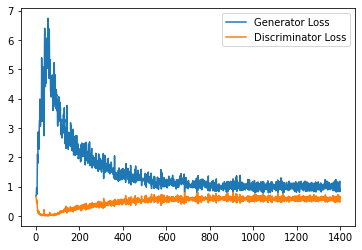

Step 28500: Generator loss: 1.023089140534401, discriminator loss: 0.580117797613144


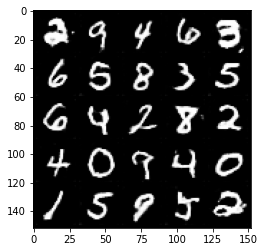

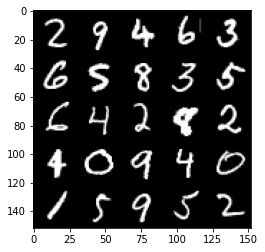

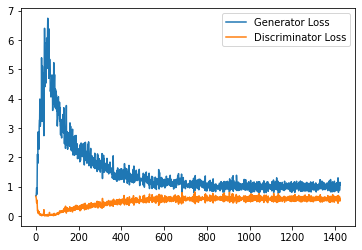

Step 29000: Generator loss: 1.0268987972736359, discriminator loss: 0.5823563100099564


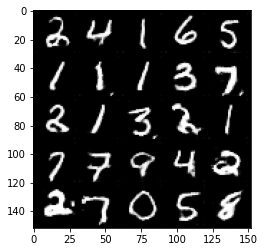

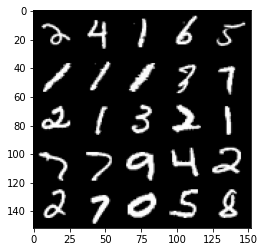

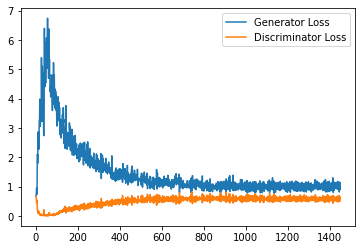

Step 29500: Generator loss: 1.035234878063202, discriminator loss: 0.5754495329260826


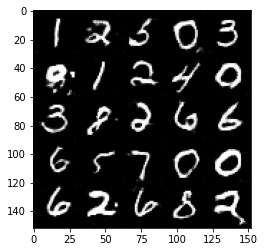

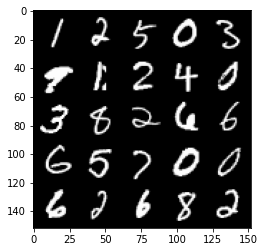

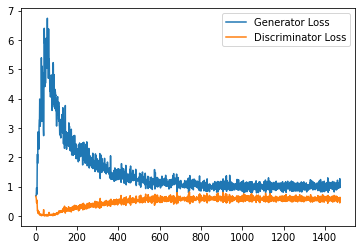

Step 30000: Generator loss: 1.0361969553232193, discriminator loss: 0.5789208710193634


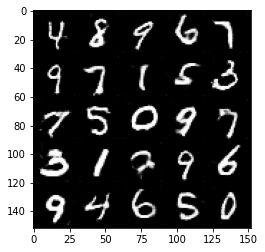

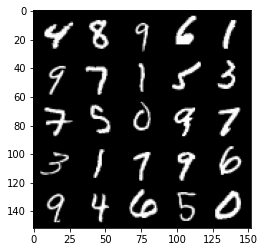

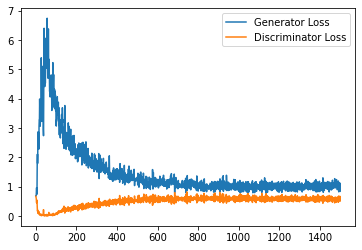

Step 30500: Generator loss: 1.0041611450910568, discriminator loss: 0.5774499608874321


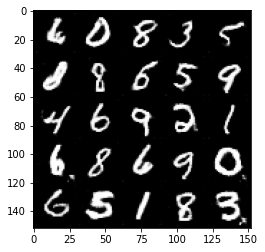

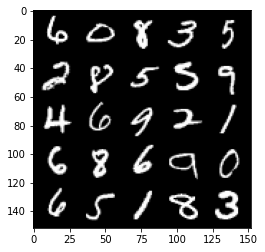

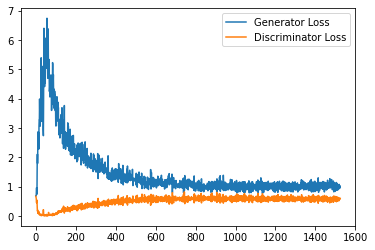

Step 31000: Generator loss: 1.0452092436552047, discriminator loss: 0.5743190056681633


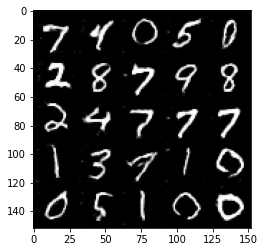

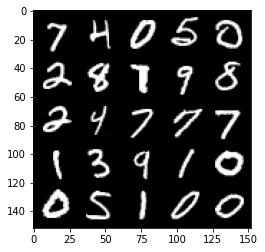

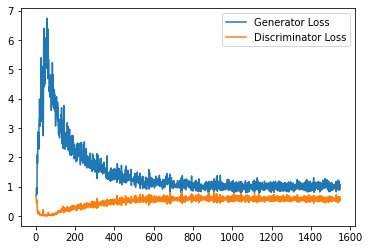

Step 31500: Generator loss: 1.0293659579753875, discriminator loss: 0.5761651737093926


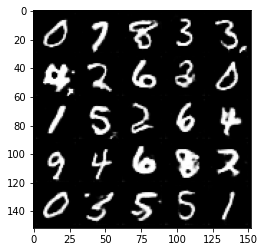

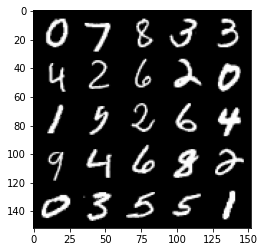

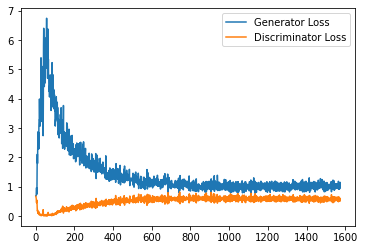

Step 32000: Generator loss: 1.038644483923912, discriminator loss: 0.5752960850596428


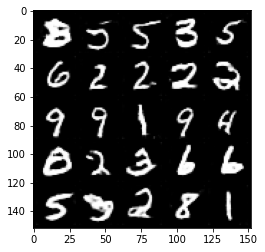

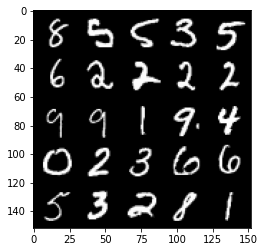

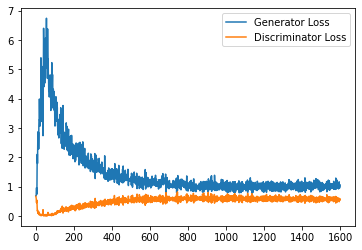

Step 32500: Generator loss: 1.0431879169940947, discriminator loss: 0.5786624448895454


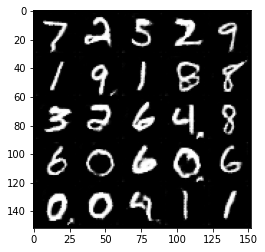

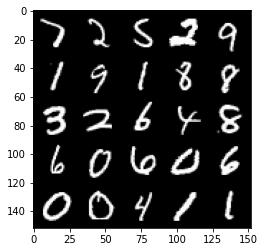

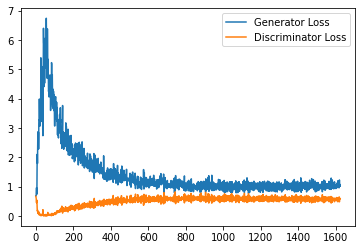

Step 33000: Generator loss: 1.079265257716179, discriminator loss: 0.5770994200706482


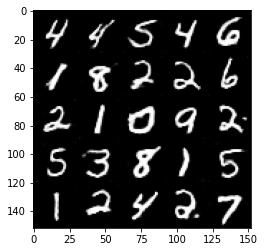

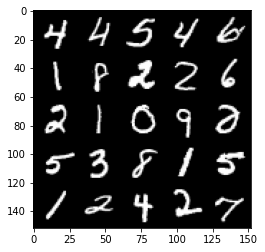

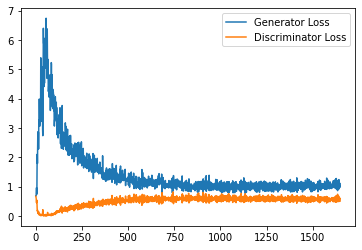

Step 33500: Generator loss: 1.0243053735494614, discriminator loss: 0.5747684751749038


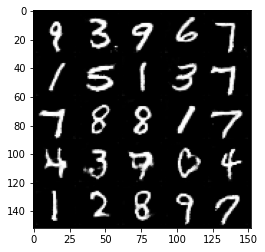

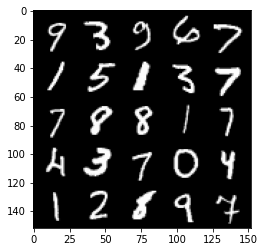

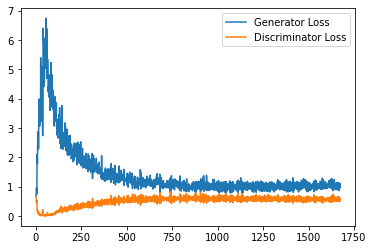

Step 34000: Generator loss: 1.0339100975990296, discriminator loss: 0.5715046439766884


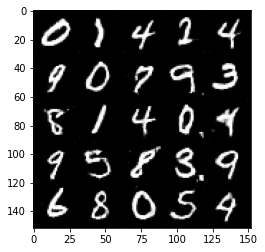

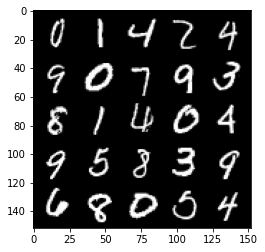

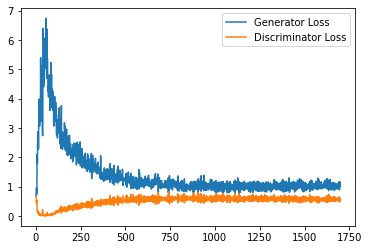

Step 34500: Generator loss: 1.0919938238859177, discriminator loss: 0.5699197735190391


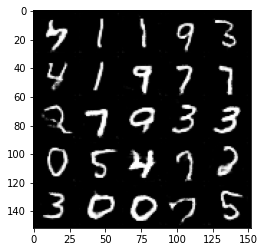

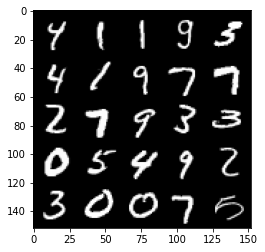

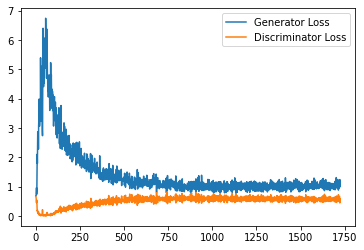

Step 35000: Generator loss: 1.0275158257484436, discriminator loss: 0.5770057223439217


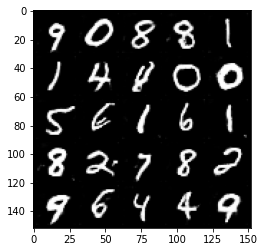

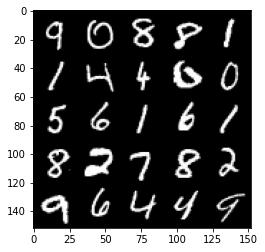

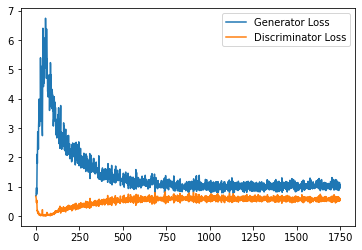

Step 35500: Generator loss: 1.0215795370340348, discriminator loss: 0.5729924112558364


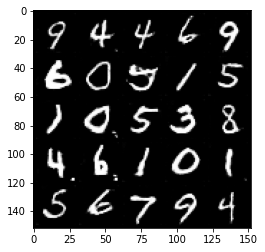

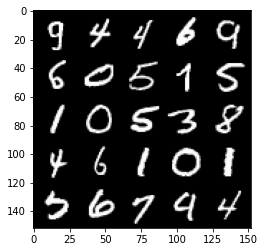

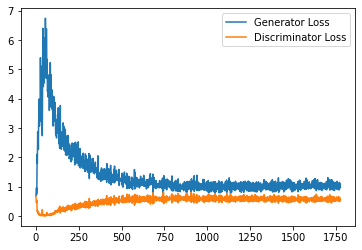

Step 36000: Generator loss: 1.028623351097107, discriminator loss: 0.5730646900534629


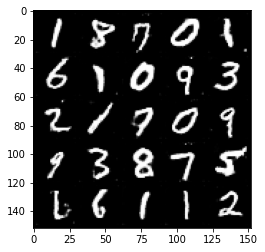

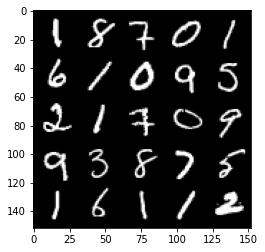

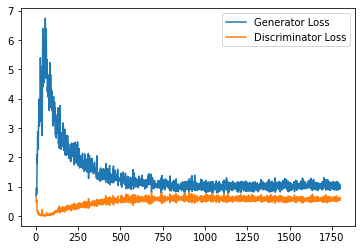

Step 36500: Generator loss: 1.0663725553750991, discriminator loss: 0.56943917375803


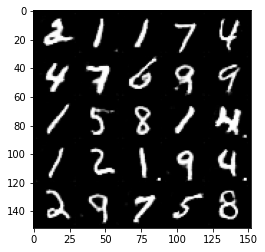

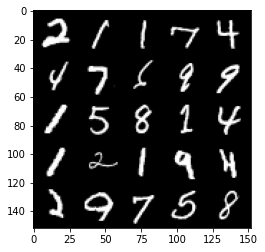

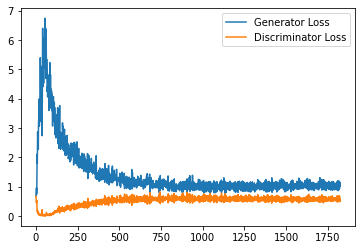

Step 37000: Generator loss: 1.0437149451971055, discriminator loss: 0.574384521484375


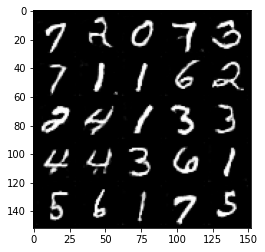

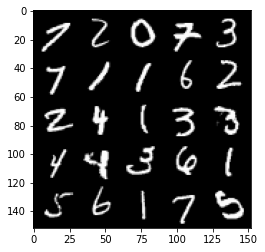

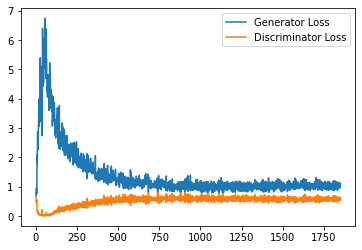

Step 37500: Generator loss: 1.029534914135933, discriminator loss: 0.5709614094495773


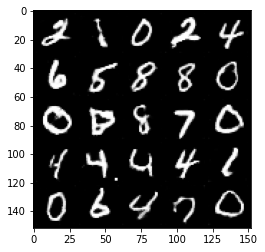

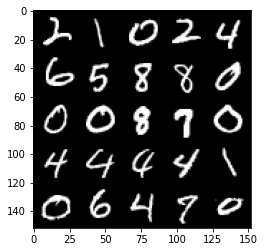

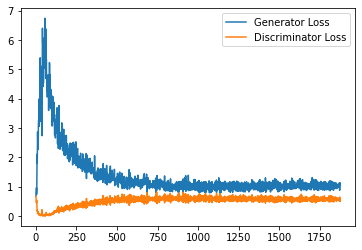

Step 38000: Generator loss: 1.0528149045705795, discriminator loss: 0.5728356118798256


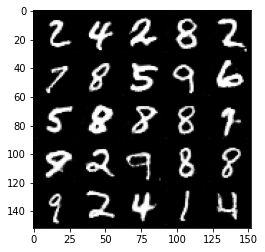

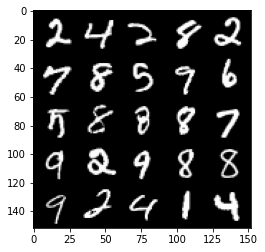

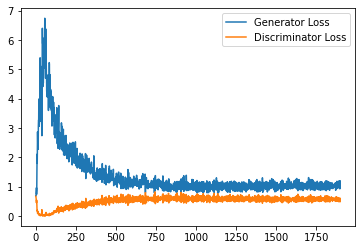

Step 38500: Generator loss: 1.04177523624897, discriminator loss: 0.5691583714485169


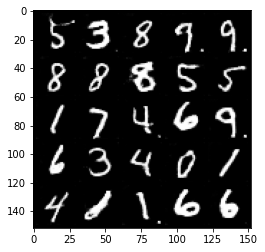

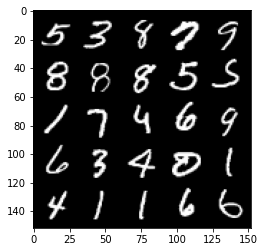

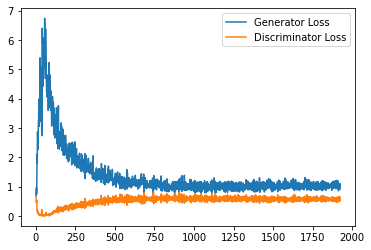

Step 39000: Generator loss: 1.0474172857999802, discriminator loss: 0.5723251561522484


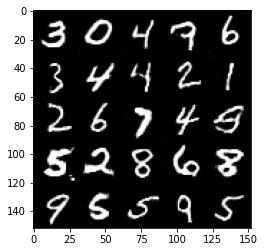

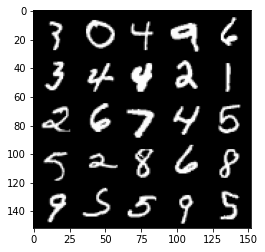

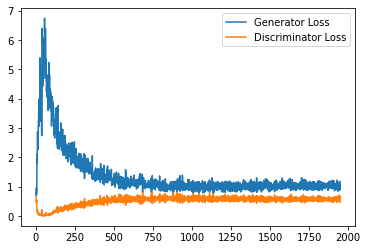

Step 39500: Generator loss: 1.0520303628444672, discriminator loss: 0.5711624436974525


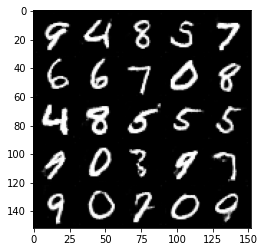

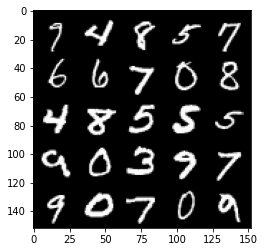

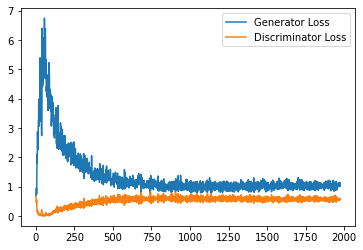

Step 40000: Generator loss: 1.0817249833345413, discriminator loss: 0.5696785898208618


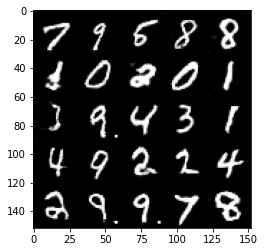

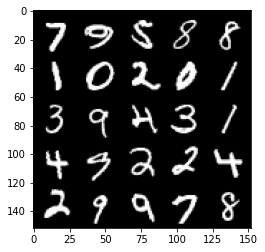

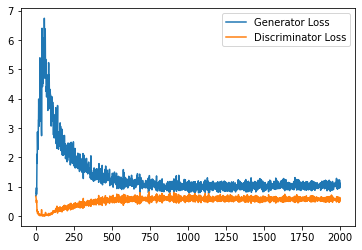

Step 40500: Generator loss: 1.0583160251379014, discriminator loss: 0.5687465574145317


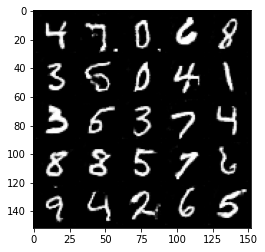

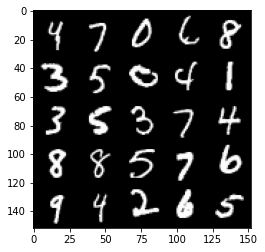

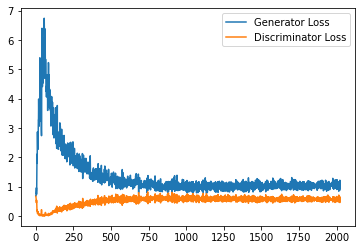

Step 41000: Generator loss: 1.056371126294136, discriminator loss: 0.5690150730013848


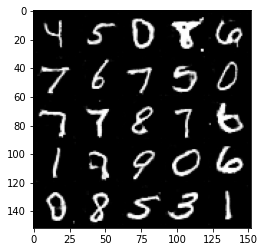

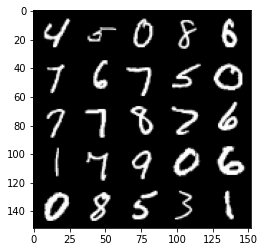

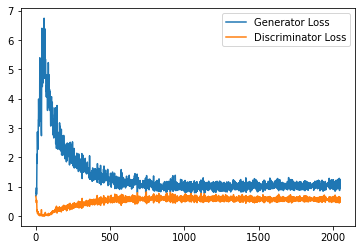

Step 41500: Generator loss: 1.056727373600006, discriminator loss: 0.5732749392390251


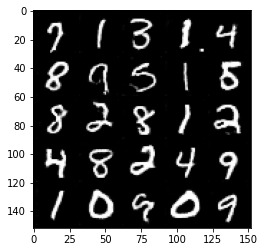

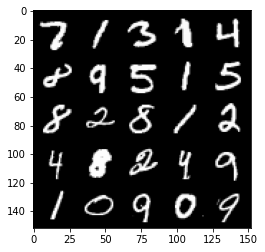

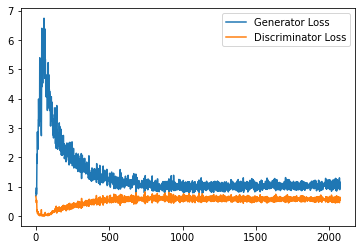

Step 42000: Generator loss: 1.0562200583219528, discriminator loss: 0.5628401111364365


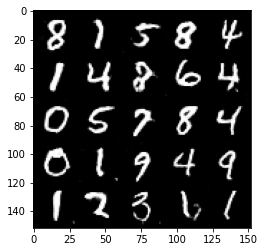

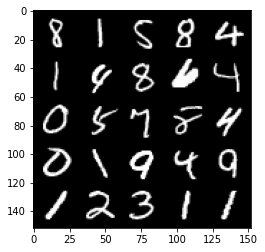

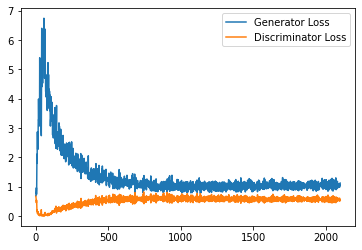

Step 42500: Generator loss: 1.062546959877014, discriminator loss: 0.5699202010035515


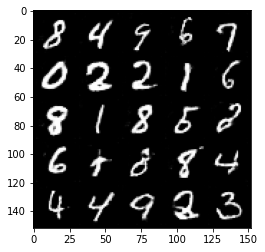

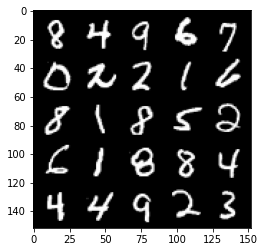

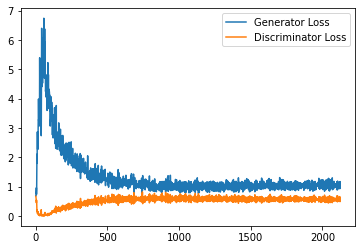

Step 43000: Generator loss: 1.0611766514778138, discriminator loss: 0.5674432212114334


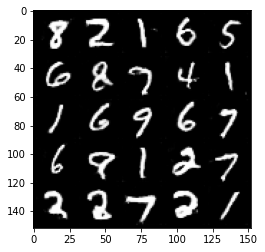

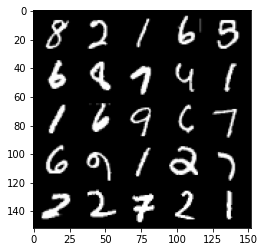

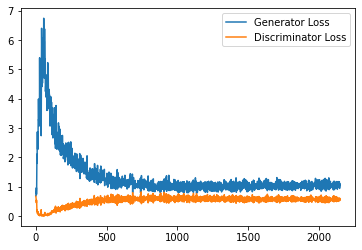

Step 43500: Generator loss: 1.0687802978754044, discriminator loss: 0.5696494958996773


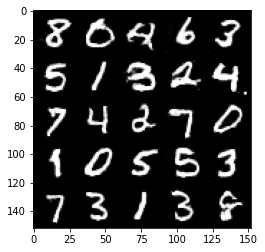

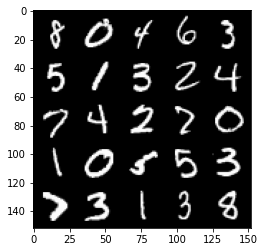

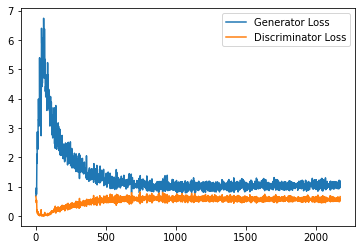

Step 44000: Generator loss: 1.085469253063202, discriminator loss: 0.5652920527458191


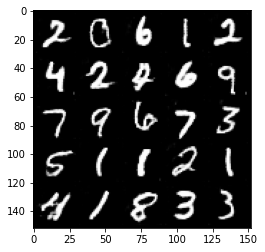

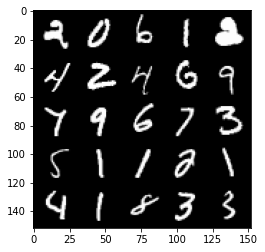

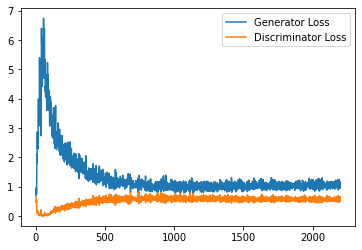

Step 44500: Generator loss: 1.0598420779705047, discriminator loss: 0.5625576802492142


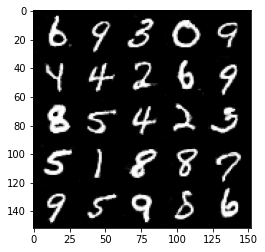

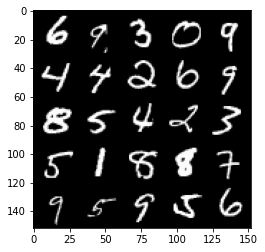

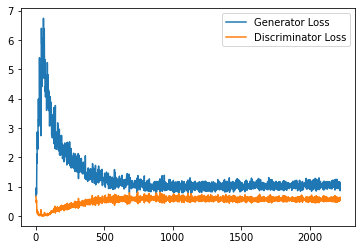

Step 45000: Generator loss: 1.0728616828918458, discriminator loss: 0.5639847409725189


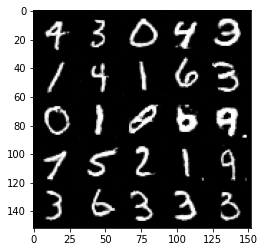

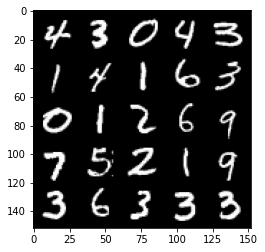

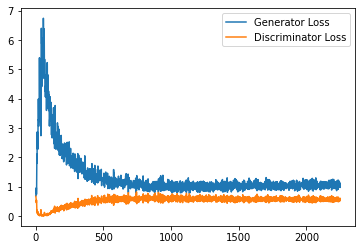

Step 45500: Generator loss: 1.071044786810875, discriminator loss: 0.56338718354702


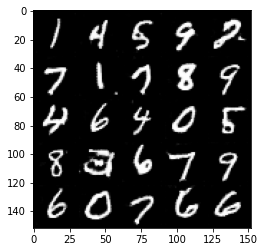

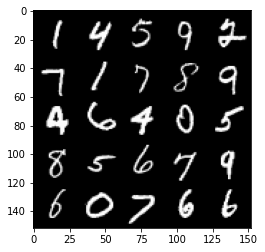

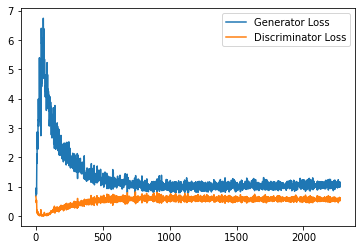

Step 46000: Generator loss: 1.0833602509498597, discriminator loss: 0.563165312230587


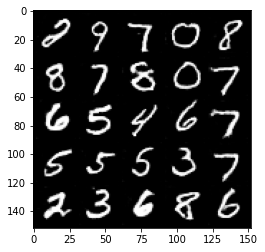

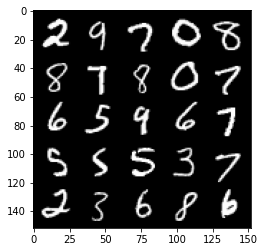

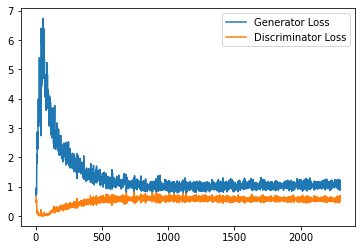

Step 46500: Generator loss: 1.0861945952177048, discriminator loss: 0.5623446698784829


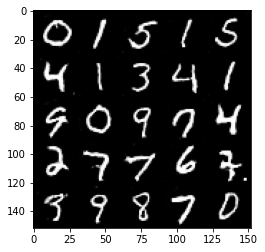

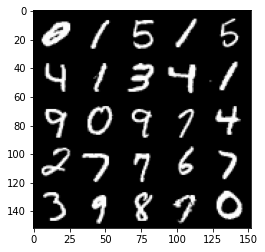

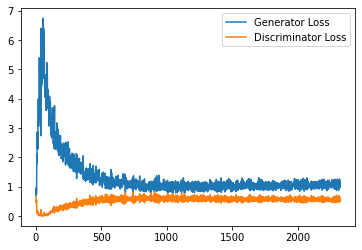

Step 47000: Generator loss: 1.0641927723884583, discriminator loss: 0.5623030706048012


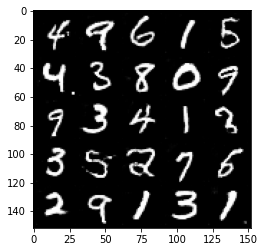

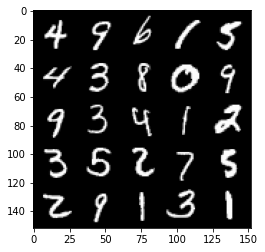

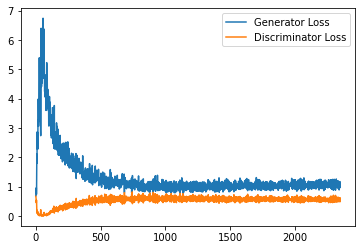

Step 47500: Generator loss: 1.0720077239274979, discriminator loss: 0.5605713860988617


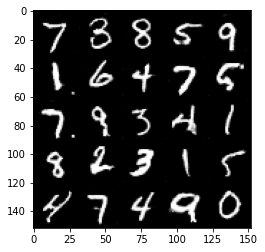

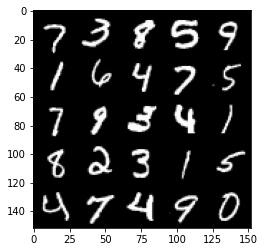

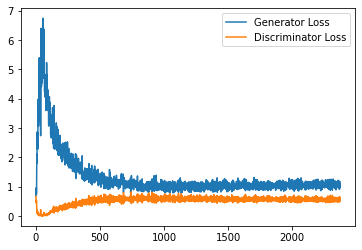

Step 48000: Generator loss: 1.0902614268064499, discriminator loss: 0.5572574284672737


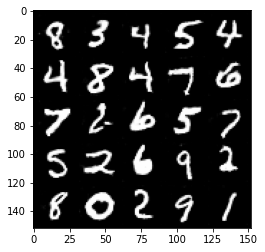

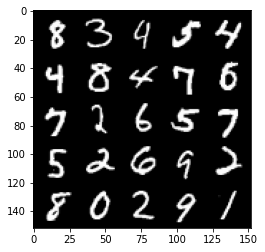

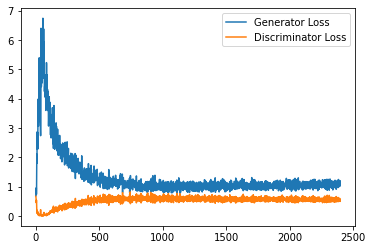

Step 48500: Generator loss: 1.0713483710289002, discriminator loss: 0.5576751623153686


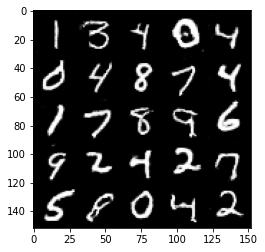

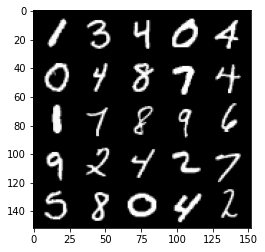

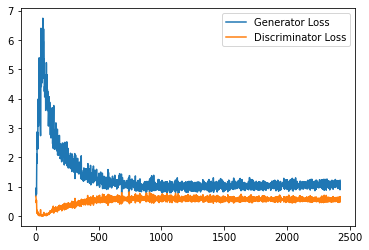

Step 49000: Generator loss: 1.0927548862695693, discriminator loss: 0.5587262066602707


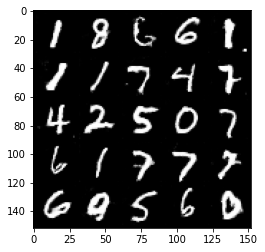

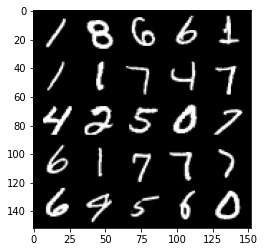

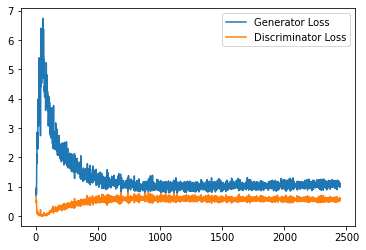

Step 49500: Generator loss: 1.0815603256225585, discriminator loss: 0.555971640765667


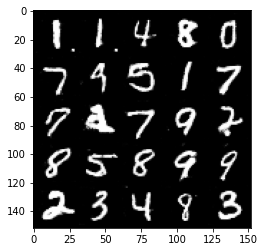

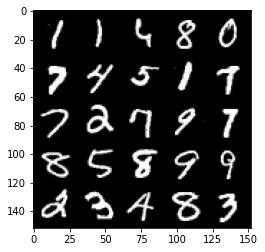

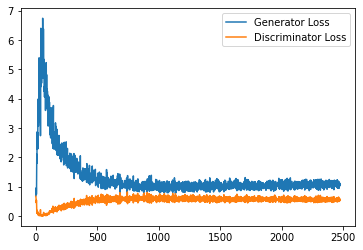

Step 50000: Generator loss: 1.095036412358284, discriminator loss: 0.5617659029364586


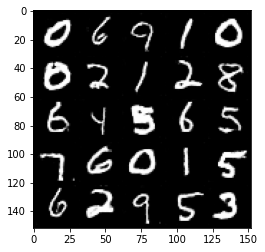

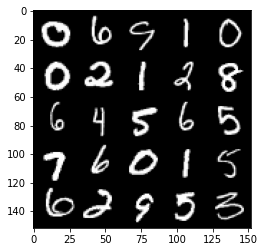

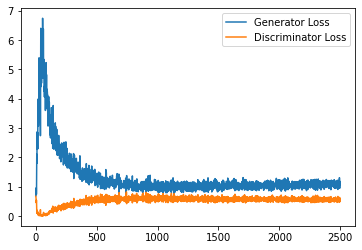

Step 50500: Generator loss: 1.103722956418991, discriminator loss: 0.5605597219467163


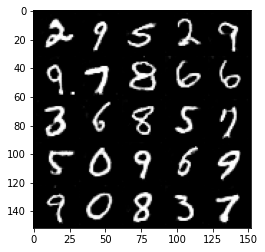

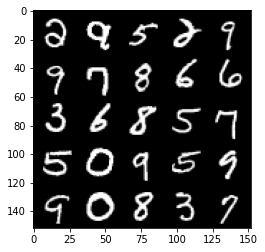

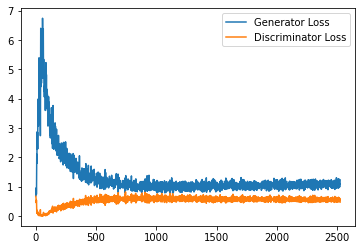

Step 51000: Generator loss: 1.0860881386995316, discriminator loss: 0.5608762650489807


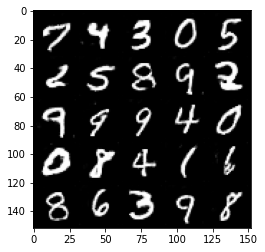

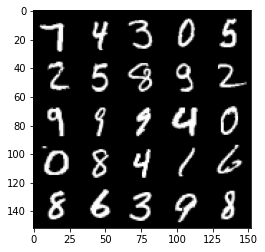

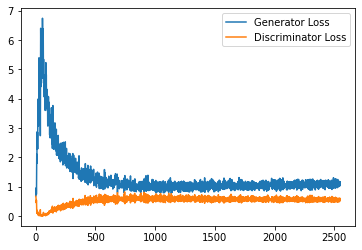

Step 51500: Generator loss: 1.0801727887392043, discriminator loss: 0.5600933149456978


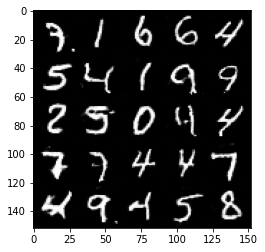

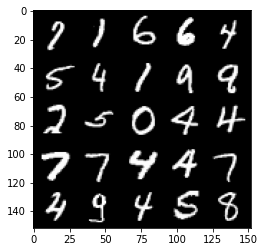

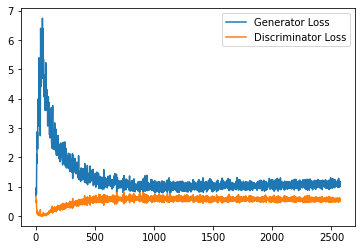

Step 52000: Generator loss: 1.0801201360225678, discriminator loss: 0.5554781606197358


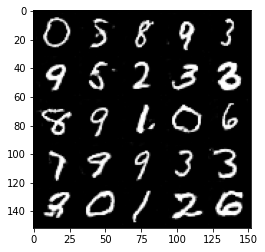

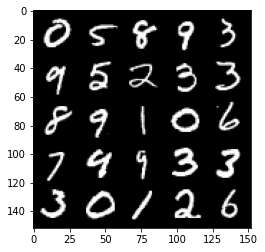

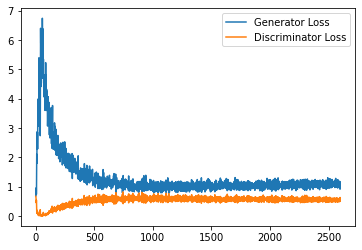

Step 52500: Generator loss: 1.0867247517108918, discriminator loss: 0.5609954905509948


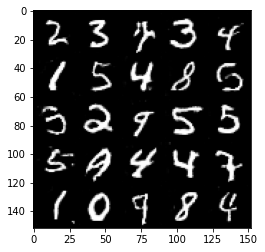

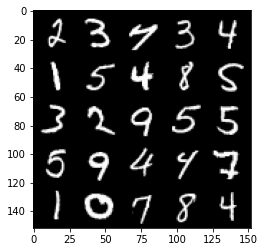

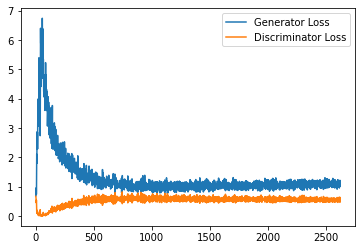

Step 53000: Generator loss: 1.1171879653930663, discriminator loss: 0.5550109847784043


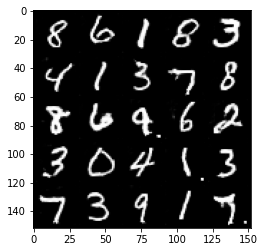

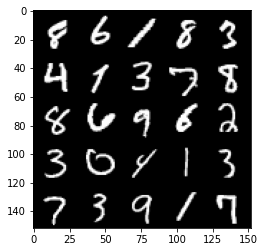

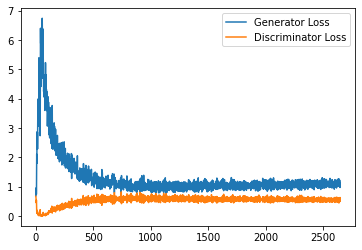

Step 53500: Generator loss: 1.0878725534677505, discriminator loss: 0.5589950077533722


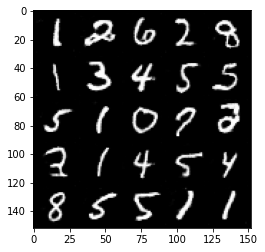

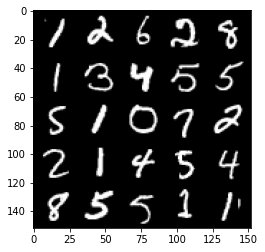

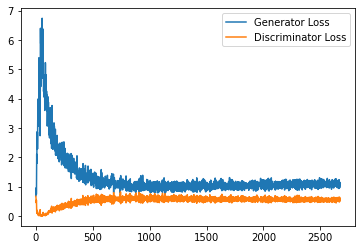

Step 54000: Generator loss: 1.101521342277527, discriminator loss: 0.5589017765522003


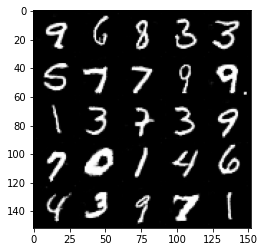

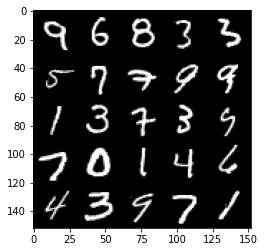

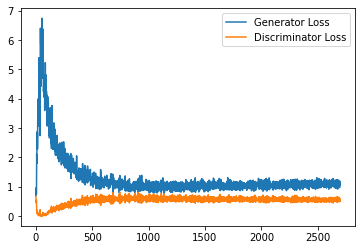

Step 54500: Generator loss: 1.0778580853939057, discriminator loss: 0.5642944151163101


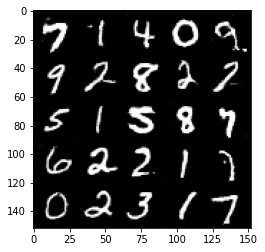

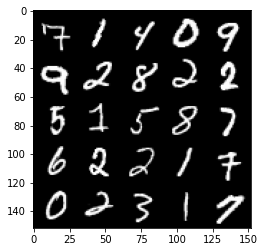

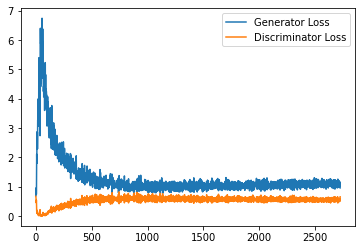

Step 55000: Generator loss: 1.1008879638910294, discriminator loss: 0.556333318054676


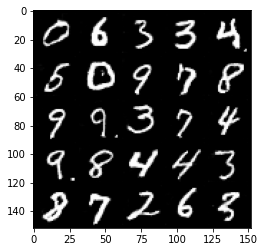

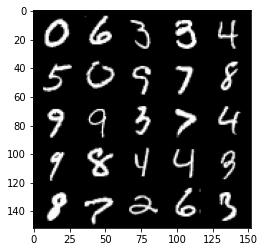

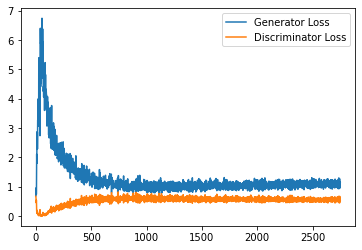

Step 55500: Generator loss: 1.1013822413682937, discriminator loss: 0.5601142649054527


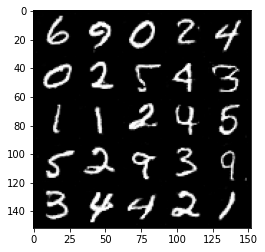

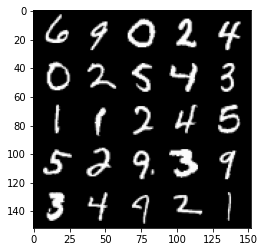

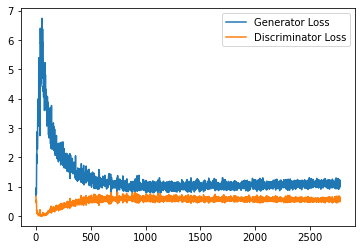

Step 56000: Generator loss: 1.1250360268354416, discriminator loss: 0.5561851967573166


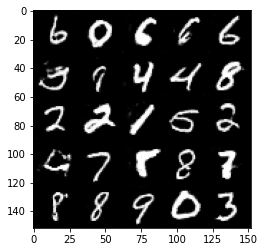

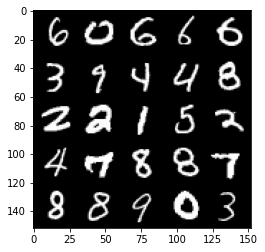

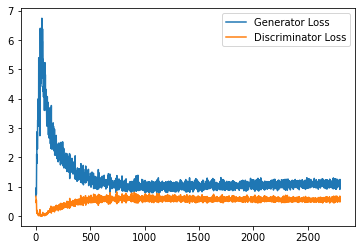

Step 56500: Generator loss: 1.0992048591375352, discriminator loss: 0.5598303396701813


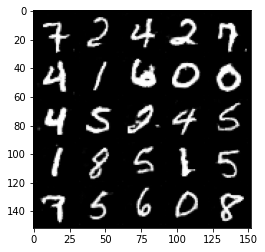

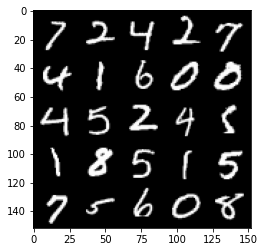

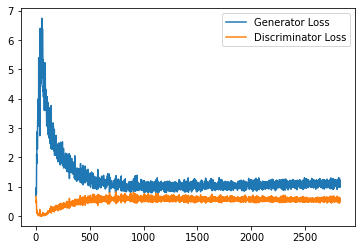

Step 57000: Generator loss: 1.0953989454507829, discriminator loss: 0.5530449823737145


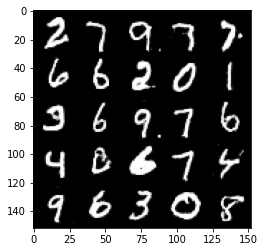

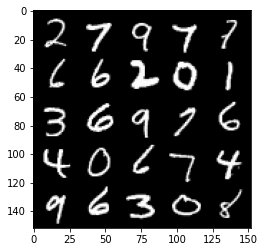

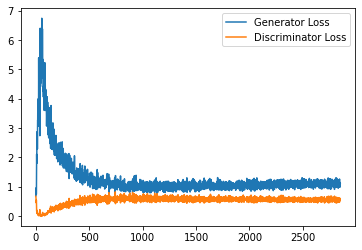

Step 57500: Generator loss: 1.099531809926033, discriminator loss: 0.5589233384728431


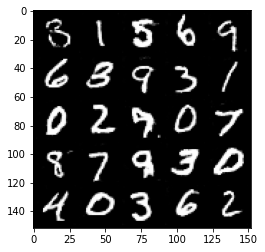

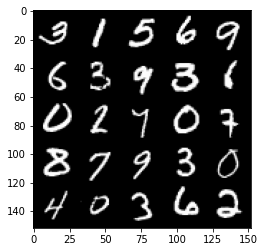

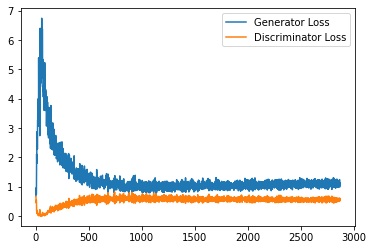

Step 58000: Generator loss: 1.0939258602857589, discriminator loss: 0.560165062725544


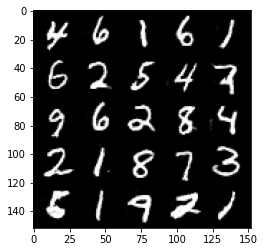

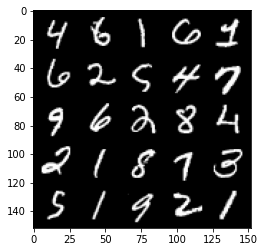

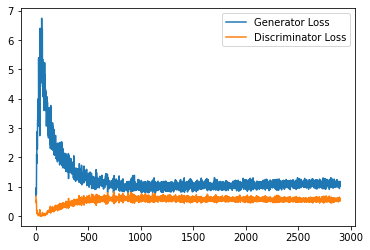

Step 58500: Generator loss: 1.1245733050107956, discriminator loss: 0.5530438103079796


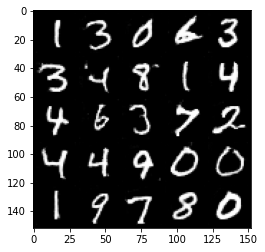

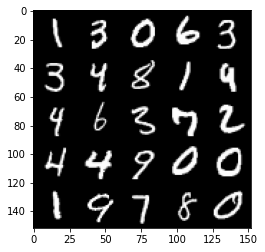

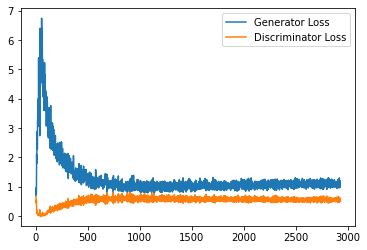

Step 59000: Generator loss: 1.1268618566989899, discriminator loss: 0.5527655979394913


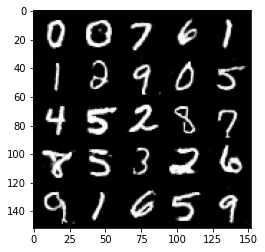

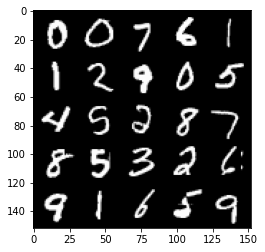

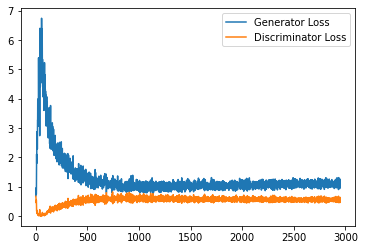

Step 59500: Generator loss: 1.1011931067705154, discriminator loss: 0.5531373257637024


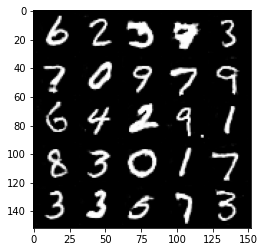

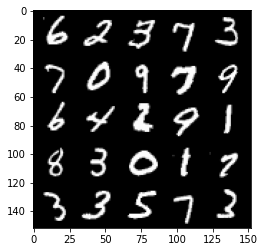

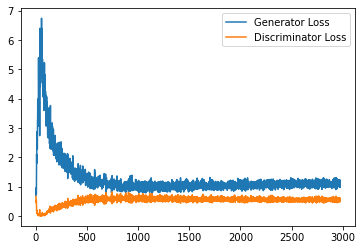

Step 60000: Generator loss: 1.1251771661043166, discriminator loss: 0.5524046756625175


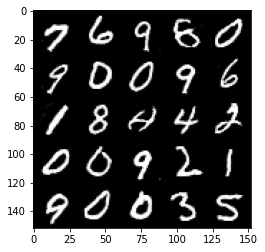

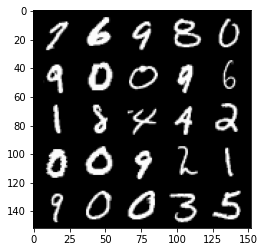

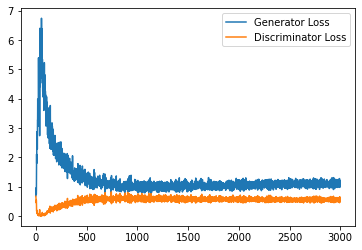

Step 60500: Generator loss: 1.0973503608703614, discriminator loss: 0.5557299073934555


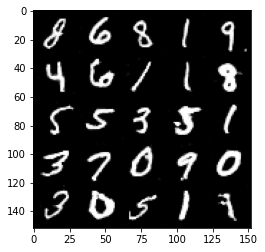

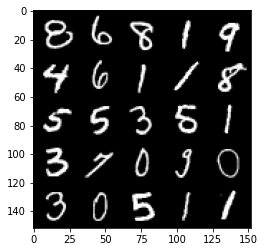

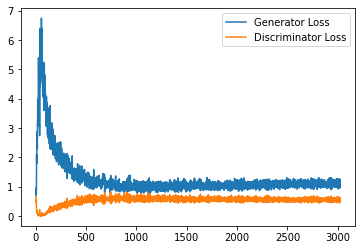

Step 61000: Generator loss: 1.1246973023414613, discriminator loss: 0.5534194825291634


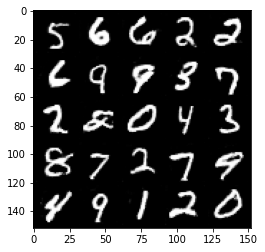

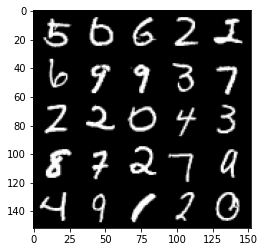

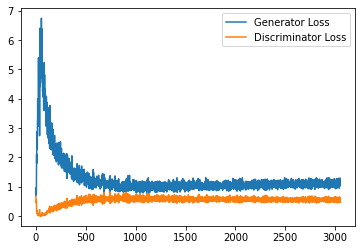

Step 61500: Generator loss: 1.1018524528741838, discriminator loss: 0.5557686708569527


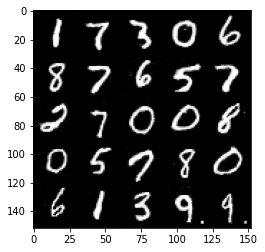

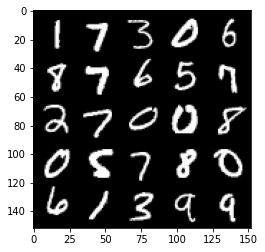

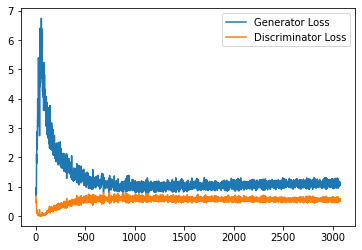

Step 62000: Generator loss: 1.1362191282510758, discriminator loss: 0.5466493128538131


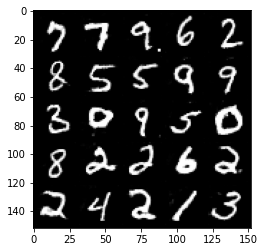

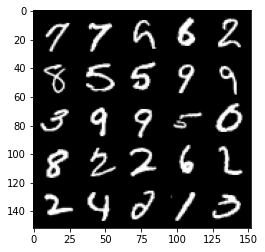

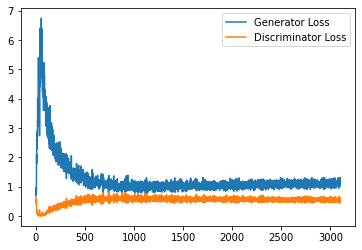

Step 62500: Generator loss: 1.1351775187253952, discriminator loss: 0.5457232332229615


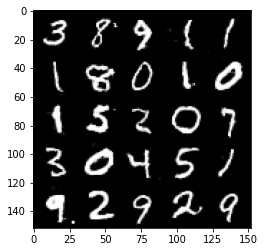

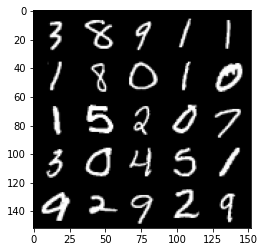

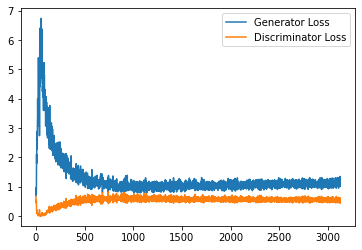

Step 63000: Generator loss: 1.1055783641338348, discriminator loss: 0.5504258401989937


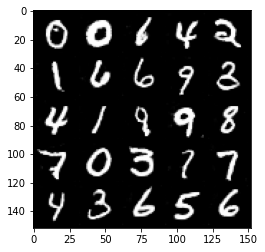

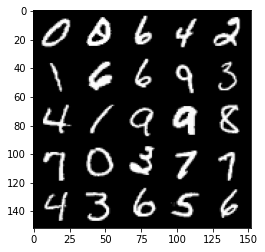

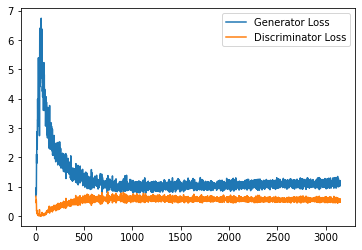

Step 63500: Generator loss: 1.118830356001854, discriminator loss: 0.5538181763887405


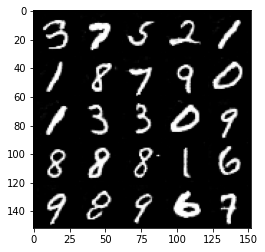

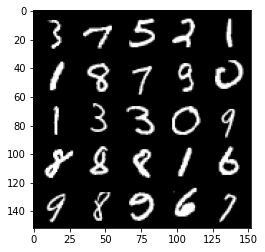

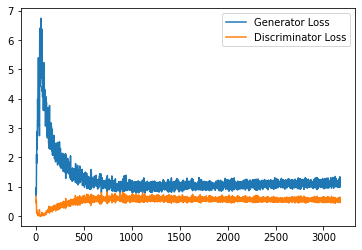

Step 64000: Generator loss: 1.151281681537628, discriminator loss: 0.5451106224060058


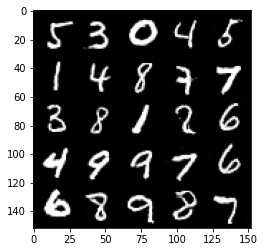

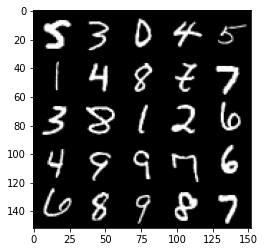

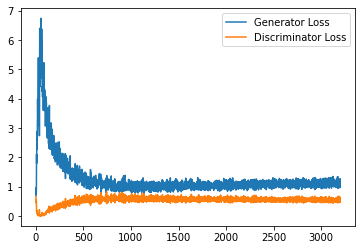

Step 64500: Generator loss: 1.131843527317047, discriminator loss: 0.5544060498476029


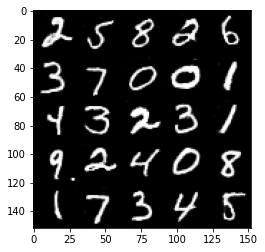

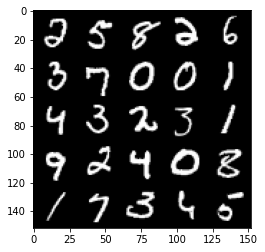

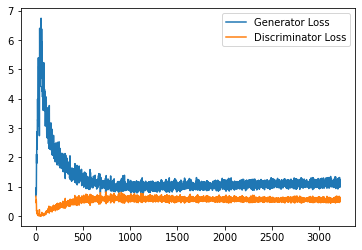

Step 65000: Generator loss: 1.1325269224643708, discriminator loss: 0.547563150703907


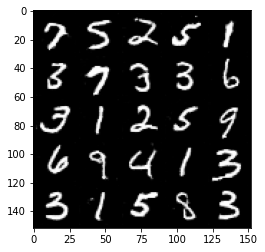

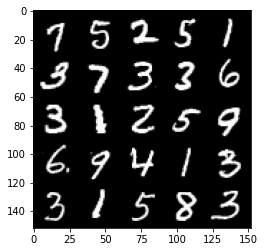

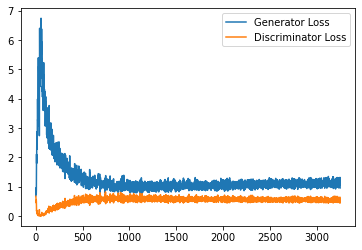

Step 65500: Generator loss: 1.1285775681734085, discriminator loss: 0.5556374198794365


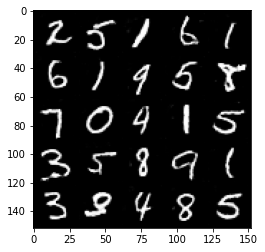

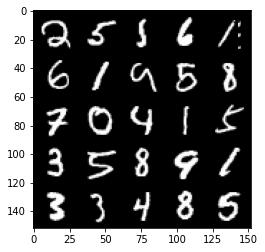

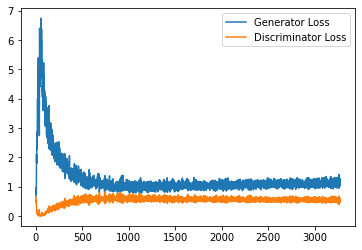

Step 66000: Generator loss: 1.0980988348722458, discriminator loss: 0.5539650149345398


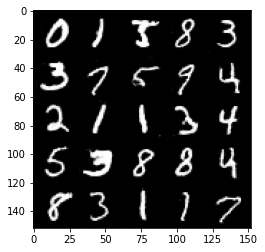

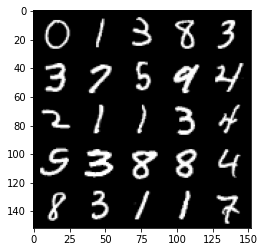

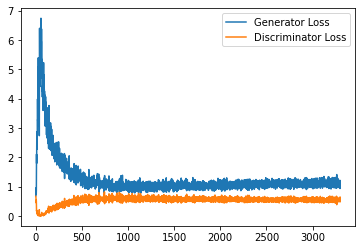

Step 66500: Generator loss: 1.1382981363534928, discriminator loss: 0.5481900970339775


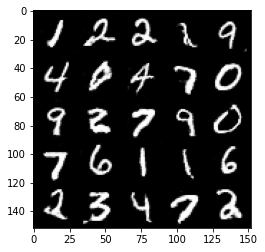

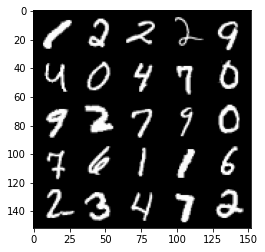

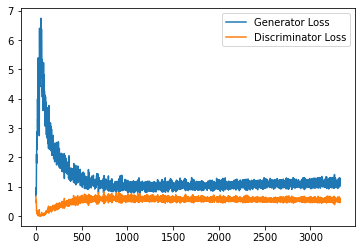

Step 67000: Generator loss: 1.1637073304653167, discriminator loss: 0.5468546553254128


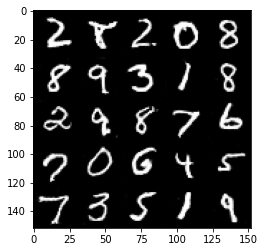

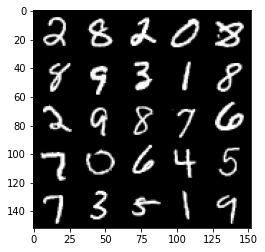

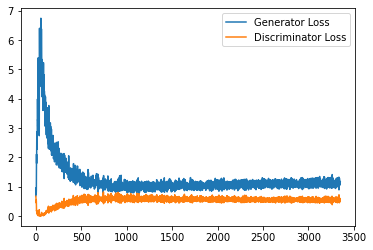

Step 67500: Generator loss: 1.115974552154541, discriminator loss: 0.5545324172377586


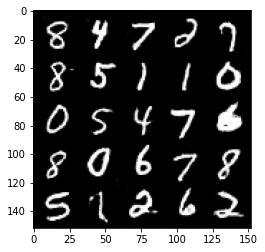

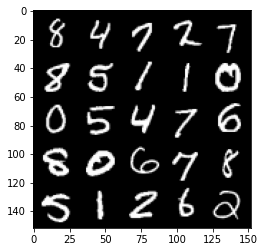

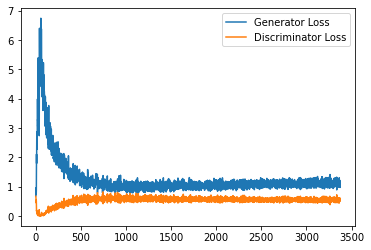

Step 68000: Generator loss: 1.1185819808244706, discriminator loss: 0.5543506969809532


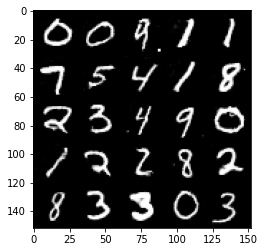

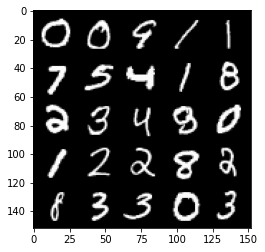

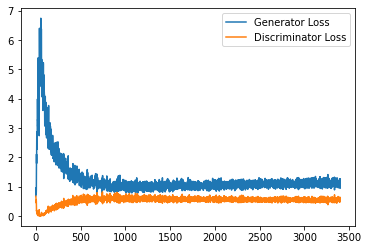

Step 68500: Generator loss: 1.1192931296825408, discriminator loss: 0.5550350153446197


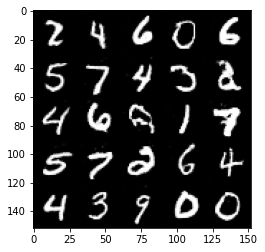

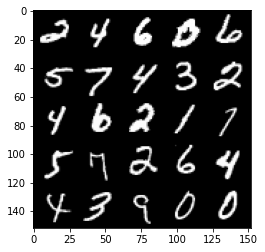

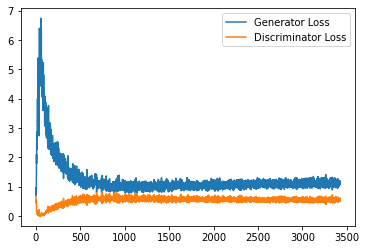

Step 69000: Generator loss: 1.1232848489284515, discriminator loss: 0.5480473295450211


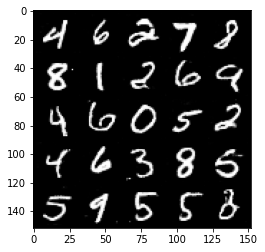

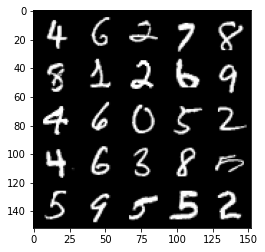

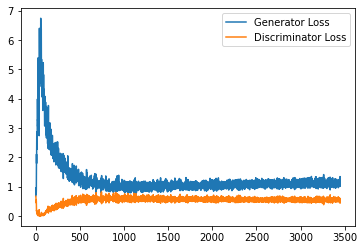

Step 69500: Generator loss: 1.1390811342000962, discriminator loss: 0.5502500871419906


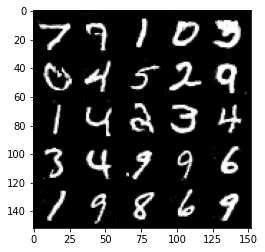

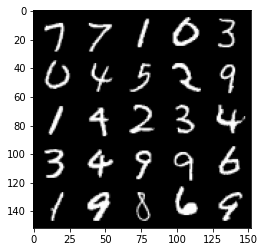

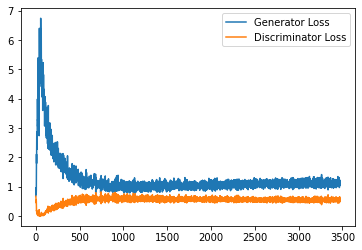

Step 70000: Generator loss: 1.1352939279079437, discriminator loss: 0.5533351624608039


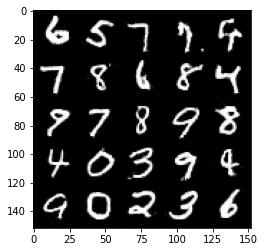

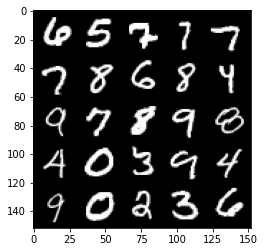

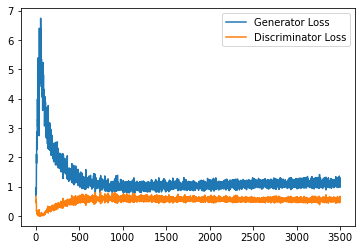

Step 70500: Generator loss: 1.1230314115285873, discriminator loss: 0.5477139520049095


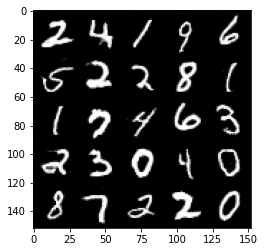

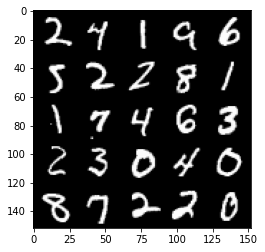

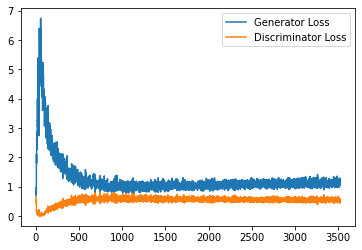

Step 71000: Generator loss: 1.1220018886327743, discriminator loss: 0.5470151216387749


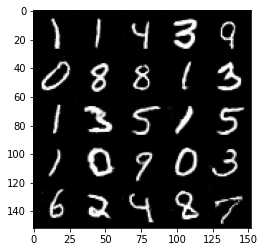

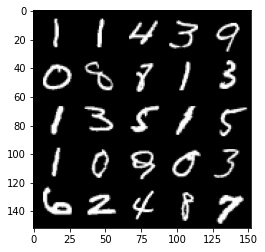

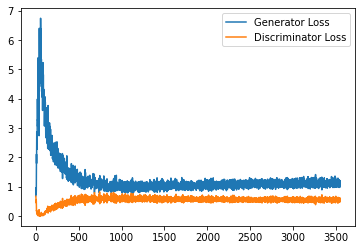

Step 71500: Generator loss: 1.1243926477432251, discriminator loss: 0.5536315507888794


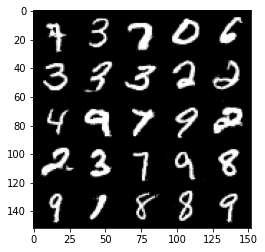

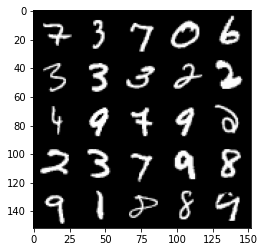

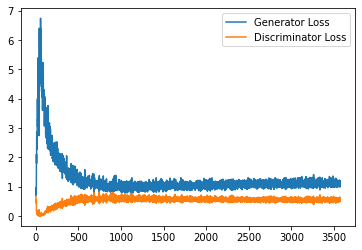

Step 72000: Generator loss: 1.13633273935318, discriminator loss: 0.5488035474419594


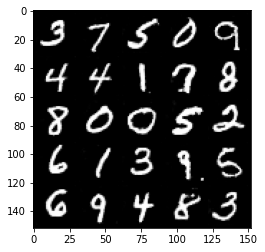

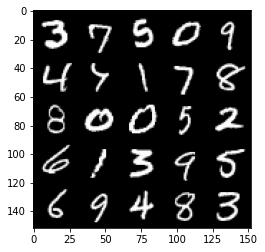

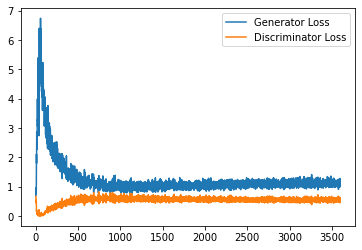

Step 72500: Generator loss: 1.135742974638939, discriminator loss: 0.550226122379303


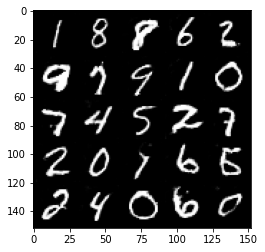

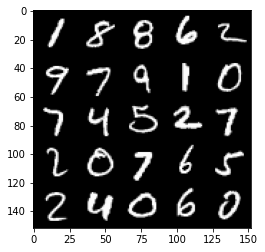

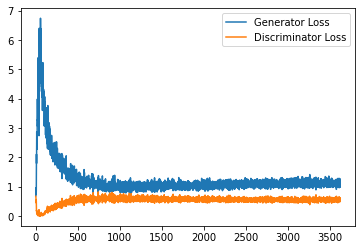

Step 73000: Generator loss: 1.1254147624969482, discriminator loss: 0.5545926347970963


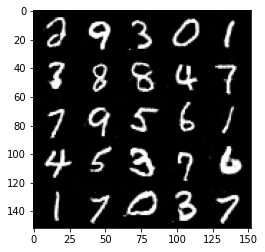

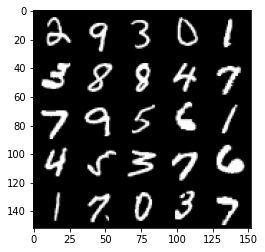

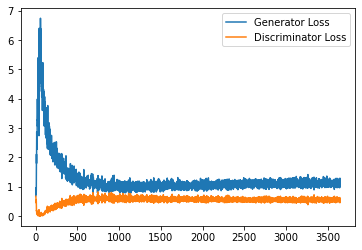

Step 73500: Generator loss: 1.1088326370716095, discriminator loss: 0.553797721683979


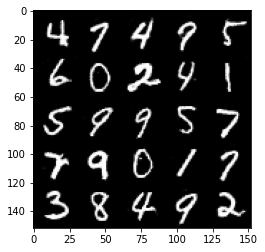

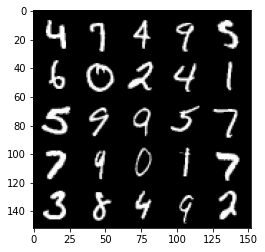

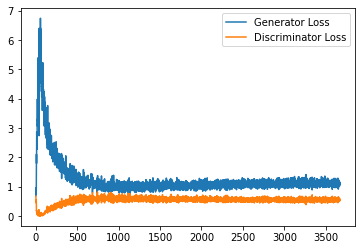

Step 74000: Generator loss: 1.1536474124193192, discriminator loss: 0.5517595095038414


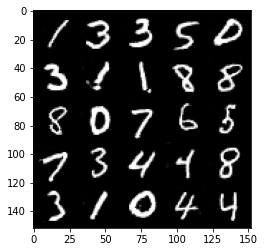

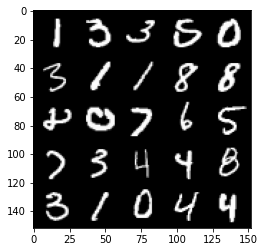

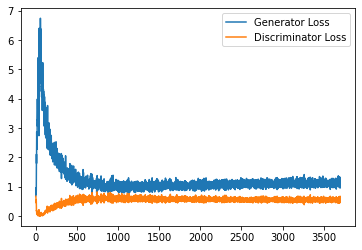

Step 74500: Generator loss: 1.1543789012432097, discriminator loss: 0.5503440434336663


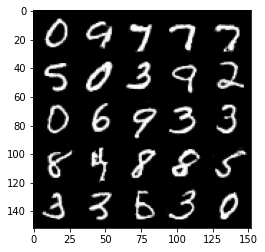

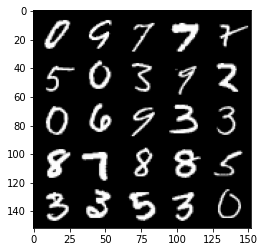

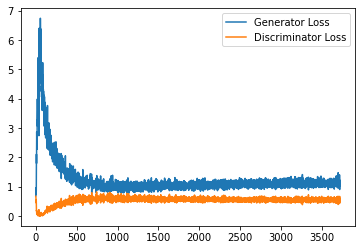

Step 75000: Generator loss: 1.1238757342100143, discriminator loss: 0.5492898174524308


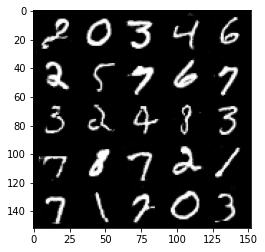

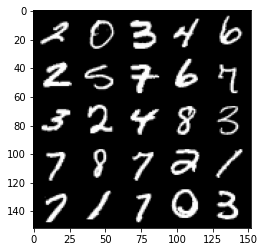

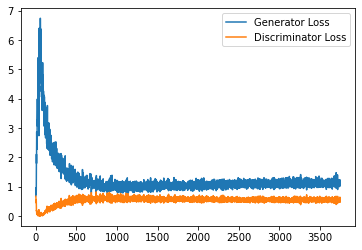

Step 75500: Generator loss: 1.1429565250873566, discriminator loss: 0.5496130324006081


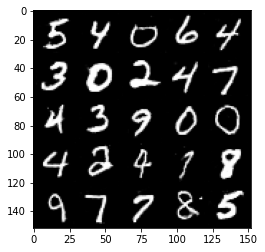

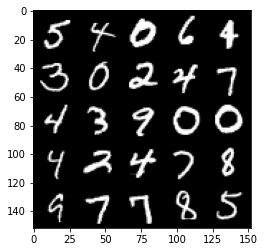

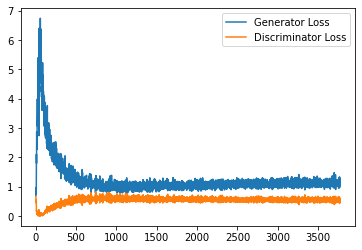

Step 76000: Generator loss: 1.1329053645133973, discriminator loss: 0.5527372253537178


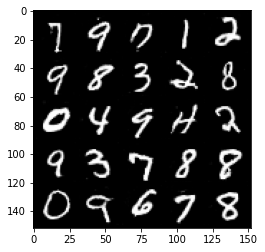

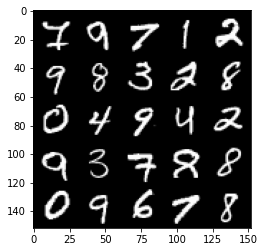

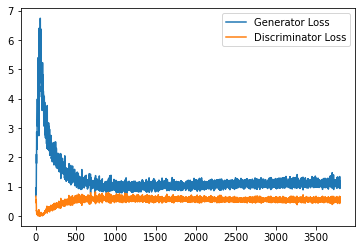

Step 76500: Generator loss: 1.13619175863266, discriminator loss: 0.5524854891300202


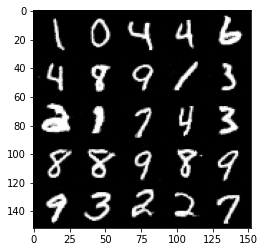

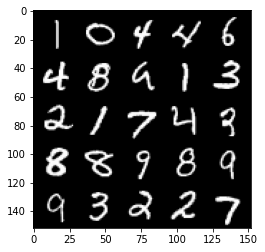

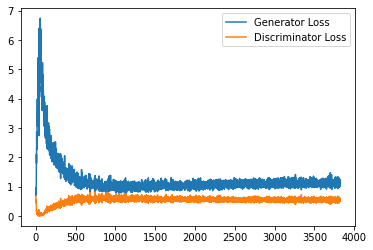

Step 77000: Generator loss: 1.117777610898018, discriminator loss: 0.554454324901104


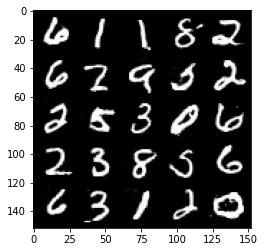

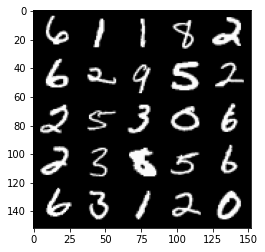

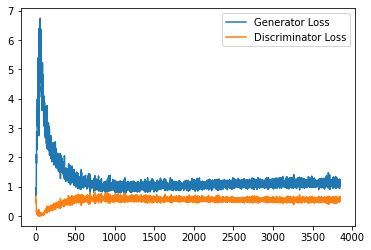

Step 77500: Generator loss: 1.1345228468179702, discriminator loss: 0.5498582989573478


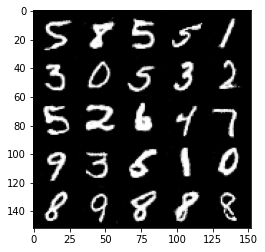

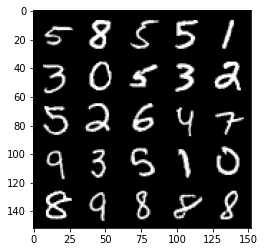

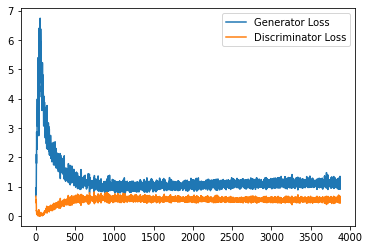

Step 78000: Generator loss: 1.129140580534935, discriminator loss: 0.5474717311859131


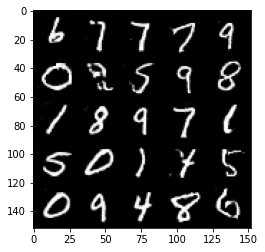

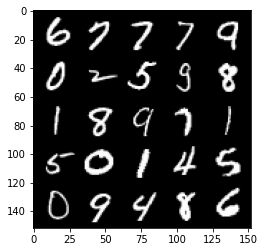

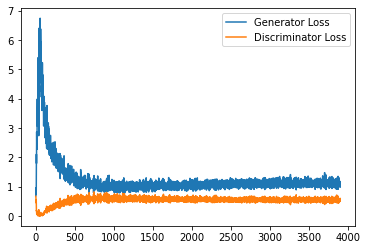

Step 78500: Generator loss: 1.1251393249034882, discriminator loss: 0.550106087744236


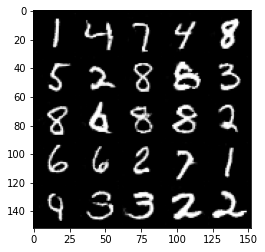

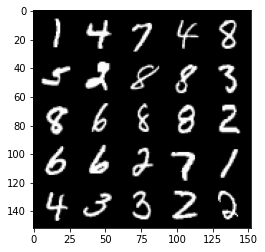

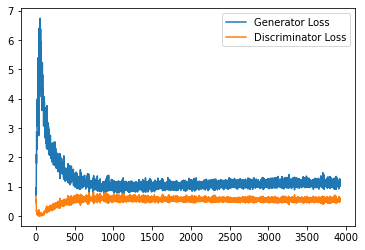

Step 79000: Generator loss: 1.1267796810865403, discriminator loss: 0.5514997294545174


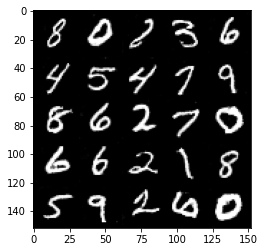

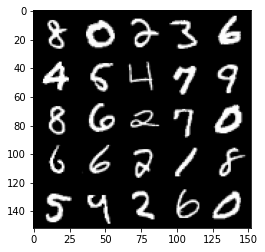

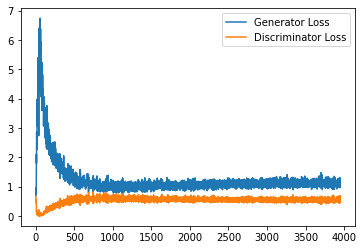

Step 79500: Generator loss: 1.1292320642471314, discriminator loss: 0.5543859987258911


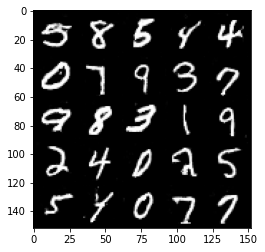

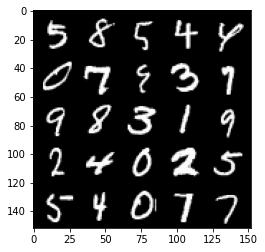

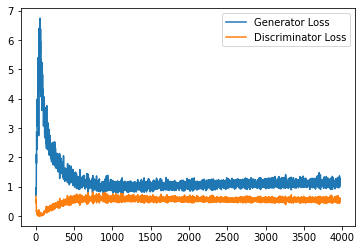

Step 80000: Generator loss: 1.1539039036035539, discriminator loss: 0.5474356988668442


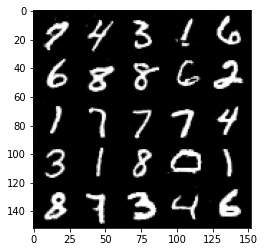

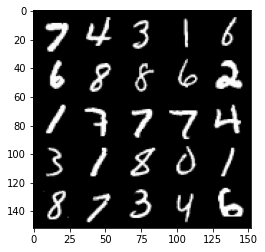

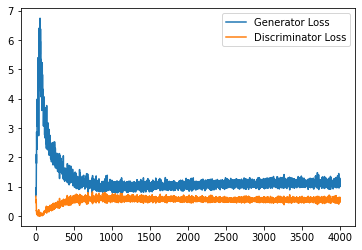

Step 80500: Generator loss: 1.1401440196037294, discriminator loss: 0.5511301718354226


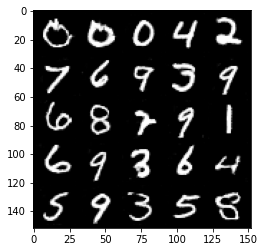

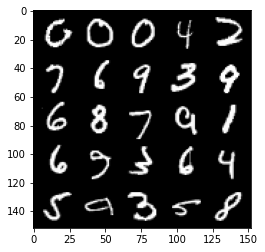

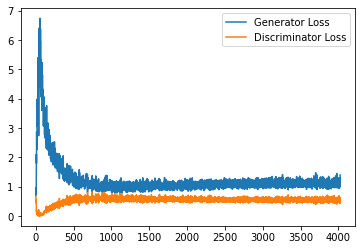

Step 81000: Generator loss: 1.1223235466480255, discriminator loss: 0.5569898138046264


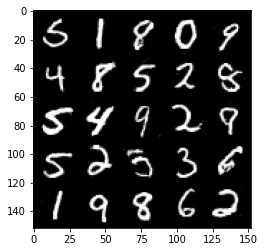

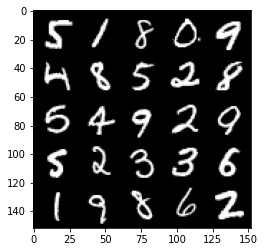

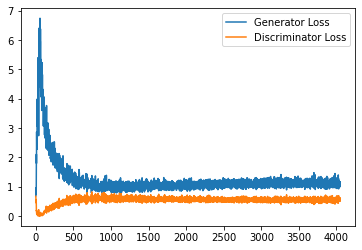

Step 81500: Generator loss: 1.1380984890460968, discriminator loss: 0.5546740447282791


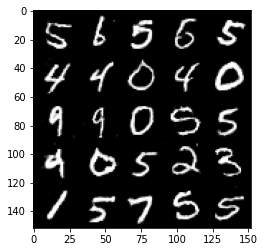

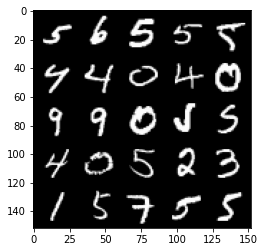

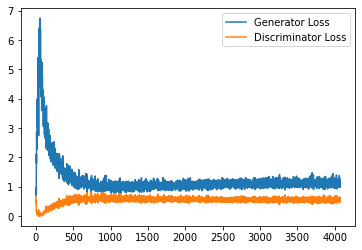

Step 82000: Generator loss: 1.1356432183980942, discriminator loss: 0.5528445731401443


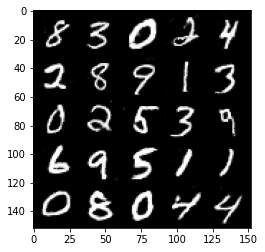

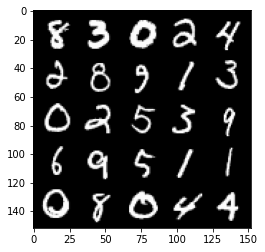

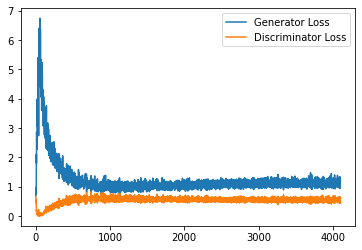

Step 82500: Generator loss: 1.1328077527284621, discriminator loss: 0.5486181335449218


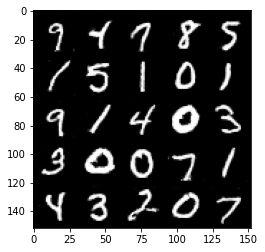

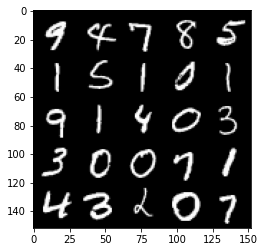

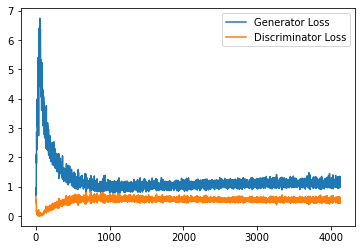

Step 83000: Generator loss: 1.140766290664673, discriminator loss: 0.5550232356190682


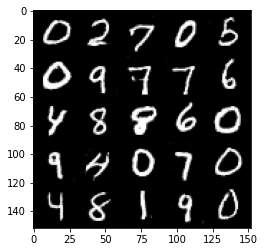

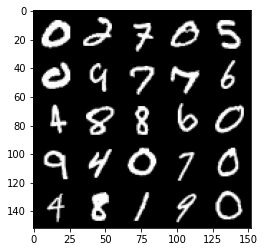

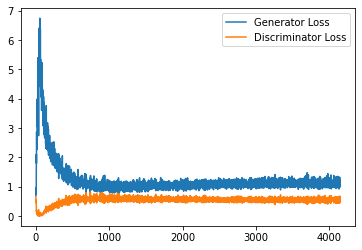

Step 83500: Generator loss: 1.1461549268364906, discriminator loss: 0.5576968799829483


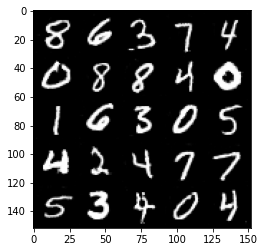

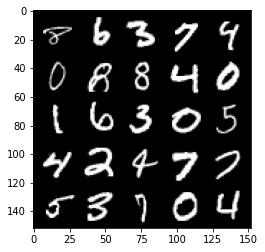

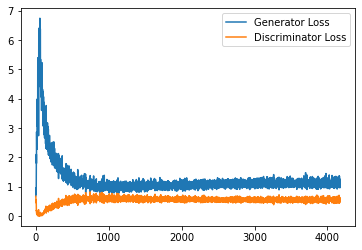

Step 84000: Generator loss: 1.1156133806705475, discriminator loss: 0.5539985113739967


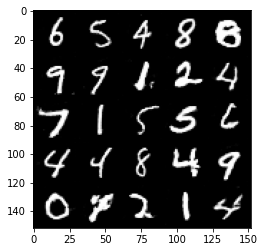

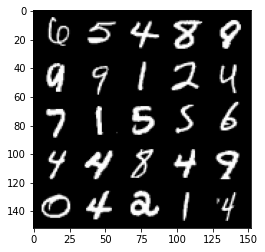

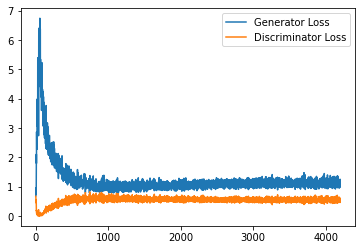

Step 84500: Generator loss: 1.1129645063877105, discriminator loss: 0.5632166398167611


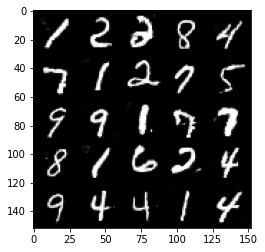

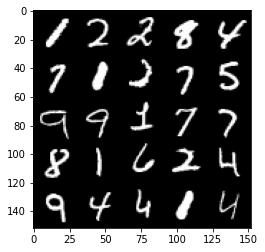

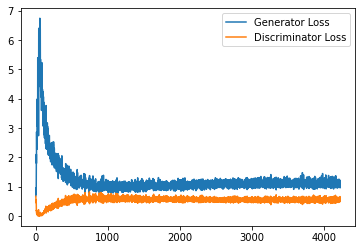

Step 85000: Generator loss: 1.1317057324647903, discriminator loss: 0.5510464728474617


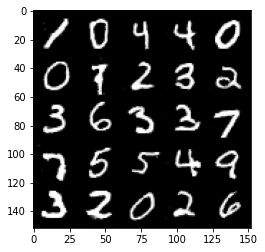

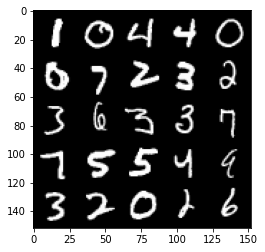

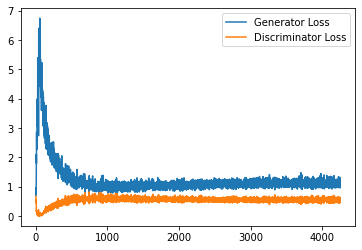

Step 85500: Generator loss: 1.1513959866762162, discriminator loss: 0.5526026459932327


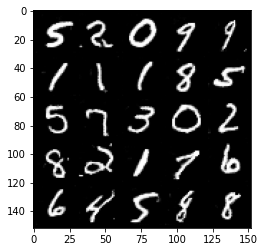

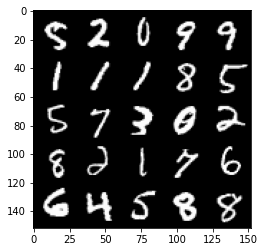

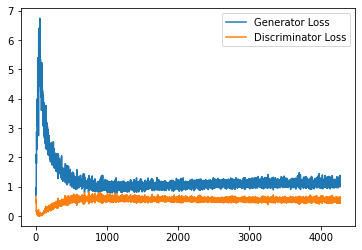

Step 86000: Generator loss: 1.153371072769165, discriminator loss: 0.5558771703243256


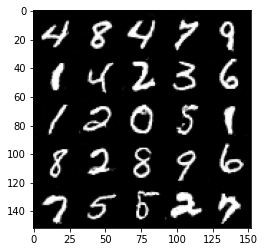

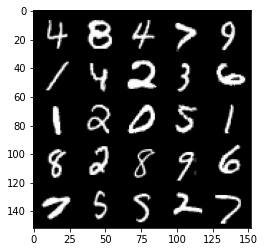

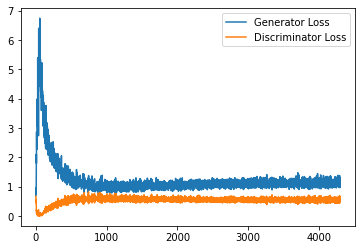

Step 86500: Generator loss: 1.1327435331344604, discriminator loss: 0.550662540435791


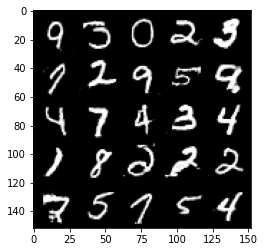

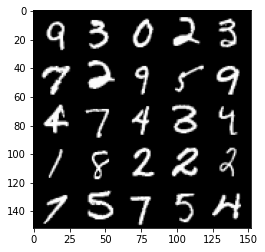

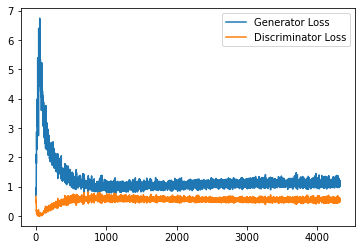

Step 87000: Generator loss: 1.1094299994707109, discriminator loss: 0.5612740722894669


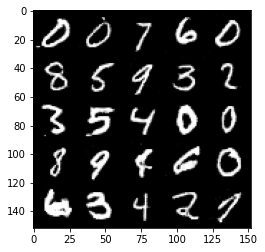

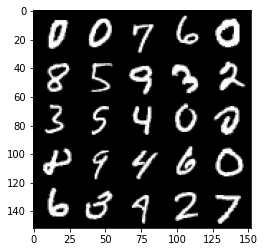

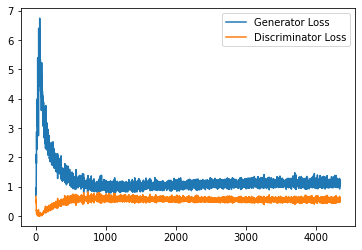

Step 87500: Generator loss: 1.1474453046321869, discriminator loss: 0.5498830966949463


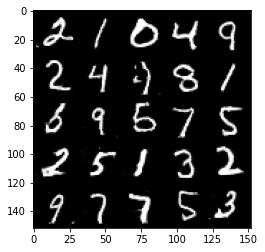

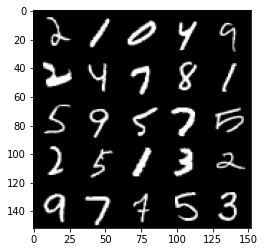

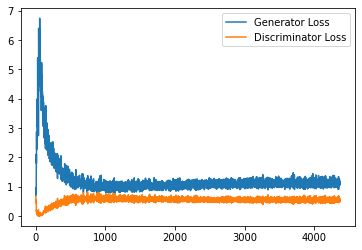

Step 88000: Generator loss: 1.1470131686925888, discriminator loss: 0.5601286408305168


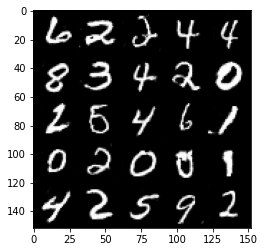

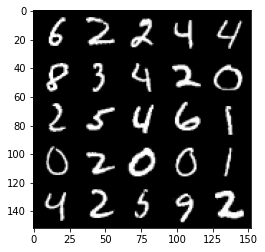

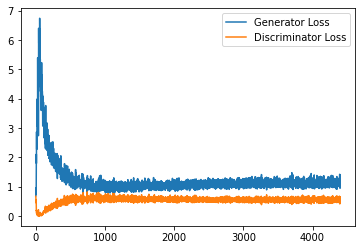

Step 88500: Generator loss: 1.1333501791954042, discriminator loss: 0.5573270829319954


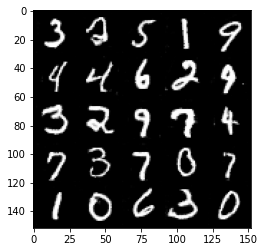

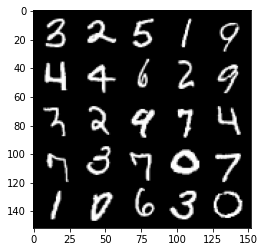

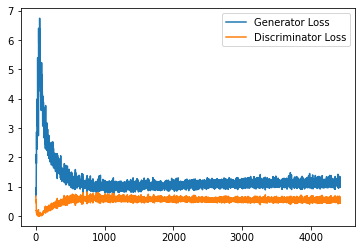

Step 89000: Generator loss: 1.147778876066208, discriminator loss: 0.5556253206133842


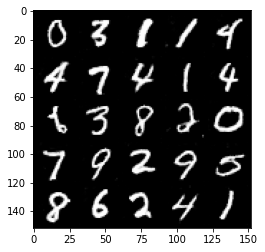

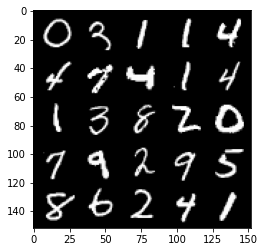

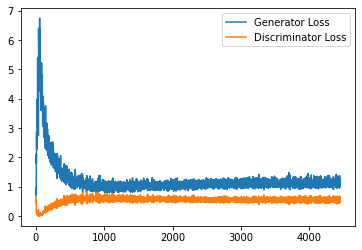

Step 89500: Generator loss: 1.1254856426715851, discriminator loss: 0.5543872414827347


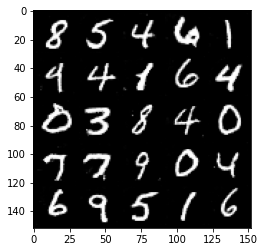

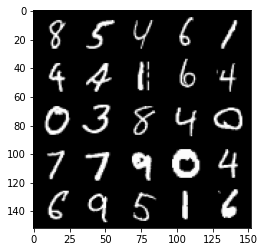

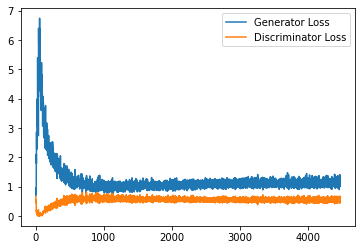

Step 90000: Generator loss: 1.1326109025478364, discriminator loss: 0.5577729095220566


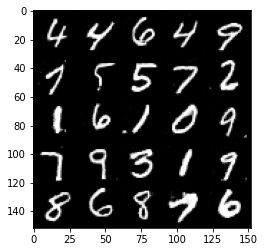

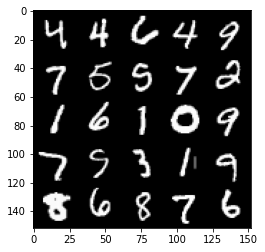

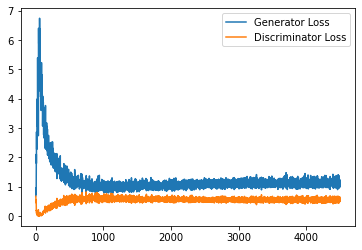

Step 90500: Generator loss: 1.1424712079167365, discriminator loss: 0.5558103708028793


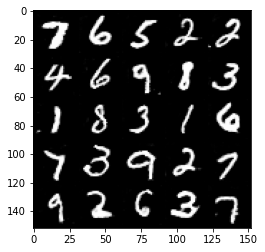

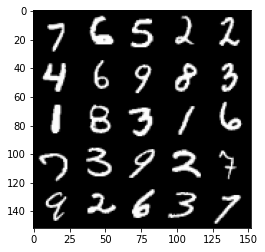

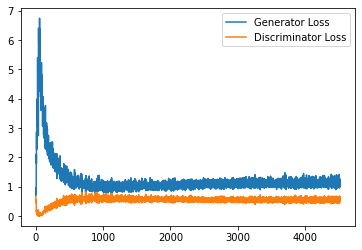

Step 91000: Generator loss: 1.1283443207740784, discriminator loss: 0.5577127687335014


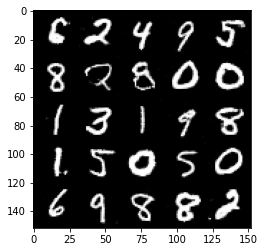

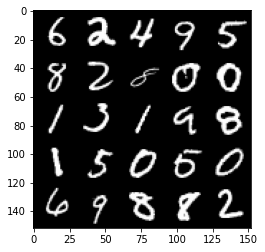

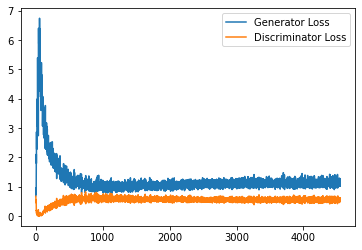

Step 91500: Generator loss: 1.1257556262016297, discriminator loss: 0.5569527921080589


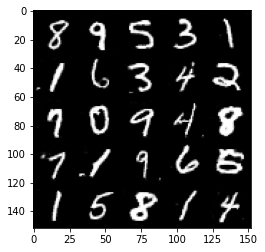

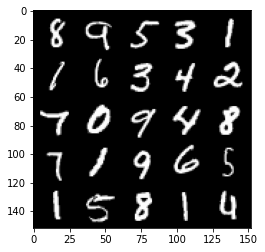

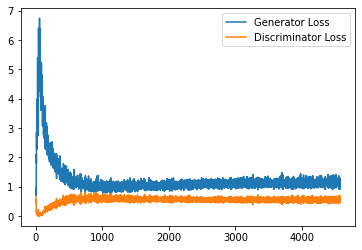

Step 92000: Generator loss: 1.1443291848897934, discriminator loss: 0.5619116404056549


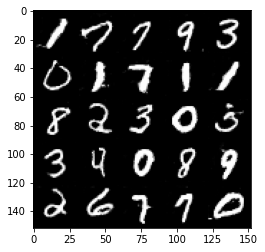

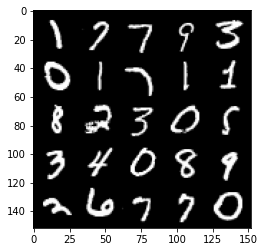

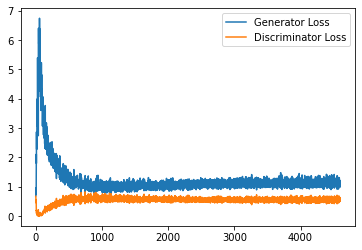

Step 92500: Generator loss: 1.1544953482151032, discriminator loss: 0.5593755775690079


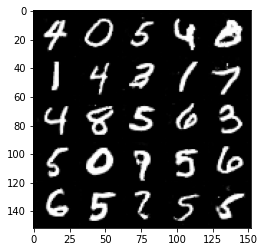

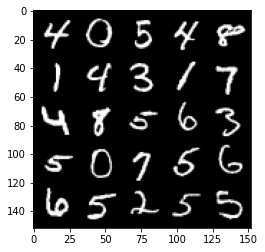

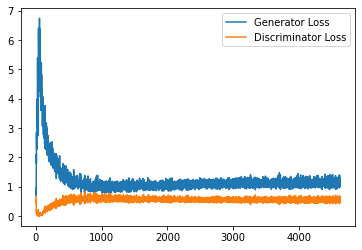

Step 93000: Generator loss: 1.1222019518613815, discriminator loss: 0.5594871411323548


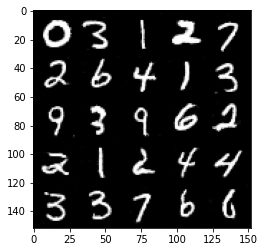

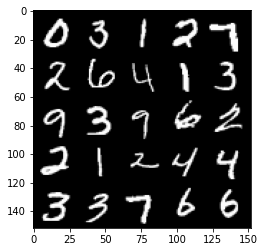

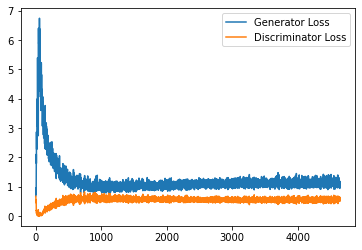

Step 93500: Generator loss: 1.1527983311414718, discriminator loss: 0.5546869303584099


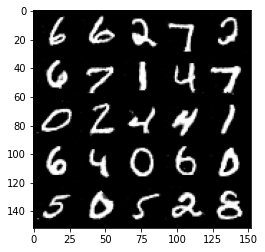

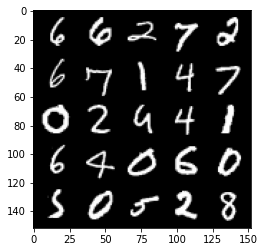

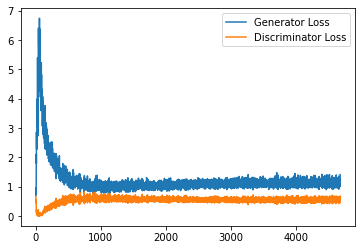

In [14]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [18]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

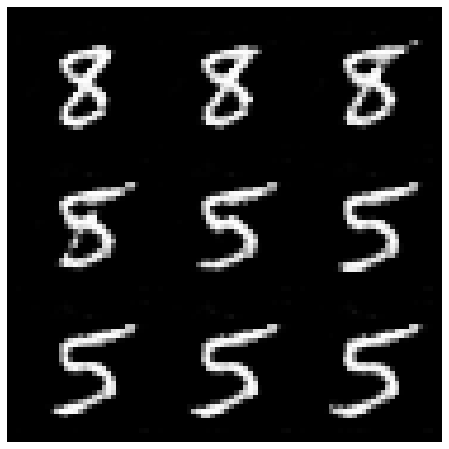

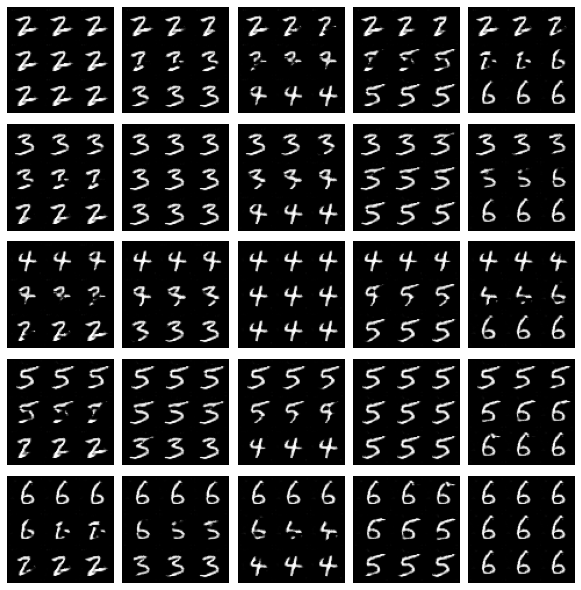

In [20]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 8 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 6]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

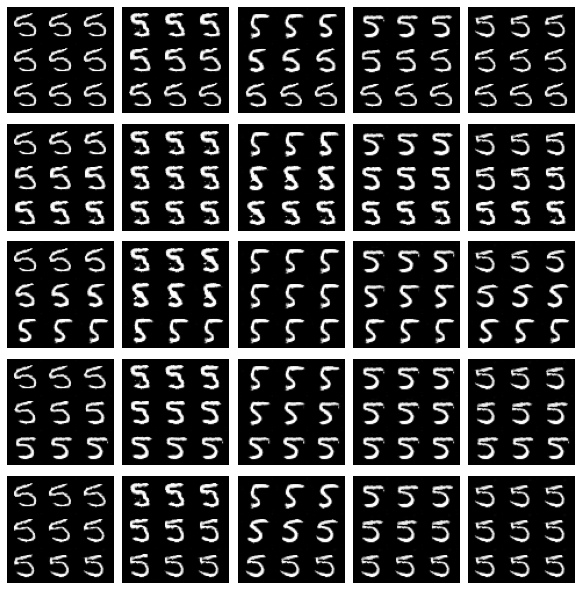

In [21]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()